# İçindekiler (Genel Notebook Düzeni 10 Puan)

# Kullanılan Kütüphaneler ve Fonksiyonlar

## Kütüphaneler

In [1]:
# Çalışma Zamanı Ölçme
import time
st = time.time()

# pandas ve numpy
import pandas as pd
import numpy as np

# Veri Önişleme
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder

# Veri Değerlendirme
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
from sklearn.neighbors import LocalOutlierFactor

# Veri Görselleştirme
import plotly.express as px
import matplotlib.pyplot as plt

# Makine Öğrenmesi Algoritmaları
from sklearn.linear_model import LogisticRegression

from sklearn.neighbors import KNeighborsClassifier

from sklearn.tree import DecisionTreeClassifier

from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.ensemble import VotingClassifier

from lightgbm import LGBMClassifier

from catboost import CatBoostClassifier

# Öznitelik Önemi Ölçme
# (Bu kütüphane için sklearn==1.2 olması gerekiyor.)
# !pip install --upgrade scikit-learn==1.2.0
import eli5
from eli5.sklearn import PermutationImportance

# Hiperparametre Ayarlama
from sklearn.model_selection import GridSearchCV

# Uyarıları kapatma
import warnings
warnings.filterwarnings('ignore')

## Fonksiyonlar (10 Puan)

In [2]:
def calc_object_cols(dataFrame, nunique = 0):
    """
    Kategorik verilere sahip kolonları bulmak için oluşturduğumuz bir fonksiyondur.
    Kolonları liste şeklinde döndürür.
    
    - nunique = en az kaç tane benzersiz bilgiye sahip kolonları almamız gerektiğini
    filtreleyen değişkenimizdir.
    
    - object_cols = kategorik verilere sahip kolonların isimlerini listeye ekler.
    
    - object_nunique = kategorik verilere sahip kolonların kaç tane benzersiz veriye
    sahip olduğunu verir.
    
    - d = Hangi kolonun kaç tane benzersiz veriye sahip olduğunu kolon ismi ile
    birlikte dictionary olarak verir.
    """
    
    object_cols = [cname for cname in dataFrame.columns if dataFrame[cname].dtype == "object" and dataFrame[cname].nunique() > nunique]
    
    object_nunique = list(map(lambda col: dataFrame[col].nunique(), object_cols))
    
    d = dict(zip(object_cols, object_nunique))
    # sözlüğümüzü sıralayarak vermek için kullanıyoruz.
    sorted(d.items(), key=lambda x: x[1])
    
    return object_cols, d

In [3]:
def create_pred_data(label, y_valid, preds, disp = None):
    
    """
    Tahminlerimizin doğruluğunu inceleyebilmek için oluşturduğumuzbir fonksiyondur.
    
    label = verilerimizin etiketidir.
    
    y_valid = target doğrulama verilerimizdir.
    
    preds = modelimizin verdiği tahminlerdir.
    
    Fonksiyonun aldığı tüm değişken türleri list'dir.
    
    Fonksiyon:
    
    digital_cm = sayısal confusion matrix oluşturur.
    percentile_cm = yüzdesel confusion matrix oluşturur.
    
    pred_percent = yüzdesel cm üzerinden doğru tahmin oranlarını çeker.
    
    Sum = sayısal cm üzerinden hangi sınıfın kaç tane veriye sahip olduğunu toplar.
    
    true = scm üzerinden her sınıf için doğru tahmin edilen verilerin sayısını listeler.
    
    false = sum - true
    
    most_frec = her sınıf için en fazla tahmin edilen sınıfı listeler. Yanlış sınıflandırmada en fazla 
    tekrar edilen sınıfa bir yanlılık olduğu gözlemlenebilir.
    """
    
    digital_cm = confusion_matrix(y_valid, preds)
    percentile_cm = confusion_matrix(y_valid, preds, normalize="true")
    
    pred_percent = [percentile_cm[i][i] for i in range(len(label))]
    Sum = [digital_cm[i].sum() for i in range(len(label))]
    true = [digital_cm[i][i] for i in range(len(label))]
    false = [Sum[i] - true[i] for i in range(len(label))]
    most_frec = [label[np.where(digital_cm[i] == max(digital_cm[i]))[0][0]] for i in range(len(label))]
    
    pred_df_list = list(zip(label, pred_percent, Sum, true, false, most_frec))

    pred_df = pd.DataFrame(pred_df_list, columns=["label", "TruePredsPercent", "Sum", "true", "false", "most_frec"])
    
    number_of_classes = pred_df["TruePredsPercent"].shape[0]
    sum_true_percentile = pred_df["TruePredsPercent"].sum()
    print(f" Toplam Doğruluk: % {(sum_true_percentile / number_of_classes) * 100}")
    
    if disp == None:
        pass
    elif disp == 0:
        print(ConfusionMatrixDisplay(confusion_matrix=percentile_cm, display_labels=[i for i in label]).plot())
    else:
        print(ConfusionMatrixDisplay(confusion_matrix=digital_cm, display_labels=[i for i in label]).plot())
        
    return pred_df

In [4]:
def model_fit_and_predict(model, y_label, X_train, y_train, X_valid, y_valid):

    """
    Model seçimi için kullanılır.
    karmaşıklık matrisi çizdirir ve tahminlerimizin üzerinde analiz yapabileceğimiz bir veri seti verir.
    """
    
    model.fit(X_train, y_train)
    preds = model.predict(X_valid)
    
    return create_pred_data(y_label, y_valid, preds, 1)

In [5]:
def fast_model_select(model_list, X, y):
    """
    Liste şeklinde kıyaslama yapacağımız modellerimizi ve tüm verilerimizi alarak 3 çapraz doğrulama oluşturup
    modellerin doğruluklarını döndürür.
    """
    
    for i, model in enumerate(model_list):
        scores = cross_val_score(model, X, y, scoring='accuracy', cv=3)
        print(f"Model {i} Accuracy: %{scores.mean()*100}")

In [6]:
def cat_summary(dataframe, col_name, plot=False, blocking=True):
    print("#"*25, col_name, "#"*25)
    print(pd.DataFrame({col_name : dataframe[col_name].value_counts(),
                       "Ratio": 100 * dataframe[col_name].value_counts() / len(dataframe)}))
    print("\n")
    
    if plot:
        sns.countplot(x=dataframe[col_name], data=dataframe)
        plt.show(block=blocking)

In [7]:
def num_summary(dataframe, numerical_col, plot=False):
    quantiles = [0.05, 0.10, 0.20, 0.30, 0.40, 0.50, 0.60, 0.70, 0.80, 0.90, 0.95, 0.99]
    return dataframe[numerical_col].describe(quantiles).T

    if plot:
        dataframe[numerical_col].hist(bins=20)
        plt.xlabel(numerical_col)
        plt.title(numerical_col)
        plt.show(block=True)

In [8]:
def target_summary_with_num(dataframe, target, numerical_col):
    return dataframe.groupby(target).agg({numerical_col: "mean"})

In [9]:
def correlation_matrix(df,cols):
    fig = plt.gcf()
    fig.set_size_inches(10, 8)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    fig = sns.heatmap(df[cols].corr(), annot=True, Linewidths=0.5, annot_kws={'size': 12}, Linecolor='w', cmap='RdBu')
    plt.show(block=True)

In [10]:
def check_df(dataframe, head=5):
    
    print("#"*25, "Shape", "#"*25)
    print(dataframe.shape)
    print("\n")
    
    print("#"*25, "Types", "#"*25)
    print(dataframe.dtypes)
    print("\n")
    
    print("#"*25, "NA", "#"*25)
    print(dataframe.isnull().sum())
    print("\n")

In [11]:
def crosscheck(df, col1, col2, info=True, plot=True):
    
    
    title = f"{col1} ve {col2}"
    
    if not plot:
        print("#"*25, title, "#"*25)

    check_col = (df.groupby([col1, col2]).agg({"index":"count"}))/df["index"].count()
    check_col.reset_index(inplace=True)


    loop_count = len(df[col1].unique()) * len(df[col2].unique())
    
        
    if plot:
        fig = px.histogram(df, x=col1, color=col2, barmode="group", title=title)
        fig.show()
        
    if info:    
        for i in range(0, loop_count):
            str1 = check_col.iloc[i][col1]
            str2 = check_col.iloc[i][col2]
            str3 = check_col.iloc[i]["index"]*100

            print(f"{str1} - {col2} - {str2} - Total Ratio:{str3}")

In [12]:
FIGSIZE = 15

def visualize_this(df, title):
  
    cols = df.columns
    num_cols = df._get_numeric_data().columns
    categorical_indexes = list(set(cols) - set(num_cols))
    numerical_indexes = df.select_dtypes(include=np.number).columns.tolist()
    
    fig, axs = plt.subplots(5,3)
    
    fig.suptitle(title)
    fig.set_figwidth(FIGSIZE)
    fig.set_figheight(FIGSIZE)
    fig.tight_layout(pad=5.0)
    ax = 0
    idx = 0
    for category in df.columns:
        if category == "index":
             continue
        if idx % 3 == 0 and idx != 0 :
                ax += 1
                idx = 0
        if category in categorical_indexes:
            slice = df[category].value_counts()
            values = slice.values
            labels = slice.index.to_list()
            axs[ax,idx].pie(values, labels=labels,autopct='%1.1f%%',startangle=45,shadow=True)
            axs[ax,idx].set_title(category)
        elif category in numerical_indexes:
             slice = df[category]
             values = slice.values
             labels = slice.index.to_list()
             axs[ax,idx].scatter(labels,values,s=2)
             axs[ax,idx].set_title(category)
        idx += 1

In [13]:
def grab_col_names(dataframe, cat_th=10, car_th=20):
    #cat_cols, cat_but_car
    cat_cols = [col for col in df.columns if str (df[col].dtypes) in ["category", "object", "bool"]]

    num_but_cat = [col for col in df.columns if df[col].nunique() < cat_th and df[col].dtypes in ["int", "float"]]

    cat_but_car = [col for col in df.columns if
                   df[col].nunique() > car_th and str(df[col].dtypes) in ["category", "object"]]
    
    cat_cols = cat_cols + num_but_cat
    cat_cols = [col for col in cat_cols if col not in cat_but_car]

    num_cols = [col for col in df.columns if df[col].dtypes in ["int", "float"]]
    num_cols = [ col for col in num_cols if col not in cat_cols]


    print(f"Observations: {dataframe.shape[0]}")
    print(f"Variables: {dataframe.shape[1]}")
    print(f'cat_cols: {len(cat_cols)}')
    print(f'num_cols: {len(num_cols)}')
    print(f'cat_but_car: {len(cat_but_car)}')
    print(f'num_but_car: {len(num_but_cat)}')
    
    return cat_cols, num_cols, cat_but_car

In [14]:
def revise_X(df):
    # özniteliklerimizi belirleyelim.
    X = df.copy()
    X.drop(["Öbek İsmi"], axis=1, inplace=True) # tüm verilerimizden hedef kolonumuzu çıkarıyoruz.

    object_cols, d = calc_object_cols(X, 0)

    ordinal_encoder = OrdinalEncoder()
    X[object_cols] = ordinal_encoder.fit_transform(X[object_cols])

    return X

# Keşifsel Veri Analizi (10 Puan)

## Verileri İçeri Aktarma

In [15]:
# Train verilerimizi içeri aktaralım.

# veri yolumuzu verelim
file_path = 'train.csv'

# verimizi okuyoruz. 
df = pd.read_csv(file_path)

# Geri bildirim alıyoruz.
print("Setup Complete")

Setup Complete


In [16]:
# Submission verilerimizi içeri aktaralım.

# veri yolumuzu verelim
file_path_sub = 'test_x.csv'

# verimizi okuyoruz. 
df_sub = pd.read_csv(file_path_sub)

# Geri bildirim alıyoruz.
print("Setup Complete")

Setup Complete


## İstatistiksel Gözlemler

In [17]:
df.head(5)

,index,Cinsiyet,Yaş Grubu,Medeni Durum,Eğitim Düzeyi,İstihdam Durumu,Yıllık Ortalama Gelir,Yaşadığı Şehir,En Çok İlgilendiği Ürün Grubu,Yıllık Ortalama Satın Alım Miktarı,Yıllık Ortalama Sipariş Verilen Ürün Adedi,Eğitime Devam Etme Durumu,Öbek İsmi,Yıllık Ortalama Sepete Atılan Ürün Adedi
0,0,Kadın,31-40,Bekar,Yüksek Lisans Mezunu,Düzenli ve Ücretli Bir İşi Var,748266.440879,Büyük Şehir,Elektronik ve Teknolojik Ürünler,32010.900881,37.310644,Etmiyor,obek_4,102.936904
1,1,Erkek,>60,Evli,Lise Mezunu,Kendi İşinin Sahibi,246298.609605,Küçük Şehir,Spor Malzemeleri,4145.729891,11.554851,Etmiyor,obek_5,82.176053
2,2,Erkek,18-30,Bekar,Lise Mezunu,Düzenli ve Ücretli Bir İşi Var,268582.732360,Küçük Şehir,Giyim,9924.379414,55.353236,Ediyor,obek_8,141.661426
3,3,Erkek,51-60,Evli,Lise Mezunu,Kendi İşinin Sahibi,327721.837865,Kırsal,Giyim,6417.780714,15.417239,Etmiyor,obek_3,17.097397
4,4,Erkek,31-40,Evli,Ortaokul Mezunu,İşsiz veya Düzenli Bir İşi Yok,397431.626948,Büyük Şehir,Giyim,7886.663061,14.689837,Etmiyor,obek_3,20.470459


In [18]:
df.tail(5)

,index,Cinsiyet,Yaş Grubu,Medeni Durum,Eğitim Düzeyi,İstihdam Durumu,Yıllık Ortalama Gelir,Yaşadığı Şehir,En Çok İlgilendiği Ürün Grubu,Yıllık Ortalama Satın Alım Miktarı,Yıllık Ortalama Sipariş Verilen Ürün Adedi,Eğitime Devam Etme Durumu,Öbek İsmi,Yıllık Ortalama Sepete Atılan Ürün Adedi
5455,5455,Kadın,>60,Bekar,Üniversite Mezunu,Emekli,478054.247819,Köy veya Kasaba,Kozmetik,43182.299801,31.356284,Etmiyor,obek_6,51.600436
5456,5456,Erkek,51-60,Evli,Doktora Ötesi,Kendi İşinin Sahibi,481852.853651,Köy veya Kasaba,Ev ve Mobilya,42107.996193,26.288620,Etmiyor,obek_6,49.190536
5457,5457,Kadın,51-60,Evli,İlkokul Mezunu,Düzenli ve Ücretli Bir İşi Var,309443.687351,Küçük Şehir,Ev ve Mobilya,4655.392445,5.156906,Etmiyor,obek_1,9.537384
5458,5458,Kadın,18-30,Bekar,Yüksekokul Mezunu,Düzenli ve Ücretli Bir İşi Var,266604.268016,Büyük Şehir,Ev ve Mobilya,9016.165906,39.205399,Ediyor,obek_8,143.281718
5459,5459,Erkek,18-30,Bekar,Yüksekokul Mezunu,Düzenli ve Ücretli Bir İşi Var,276155.078333,Büyük Şehir,Spor Malzemeleri,9455.657480,50.554188,Ediyor,obek_8,127.329348


In [19]:
# dataframemizin bilgilerini kontrol ediyoruz.
# df.info()
check_df(df)

######################### Shape #########################
(5460, 14)


######################### Types #########################
index                                           int64
Cinsiyet                                       object
Yaş Grubu                                      object
Medeni Durum                                   object
Eğitim Düzeyi                                  object
İstihdam Durumu                                object
Yıllık Ortalama Gelir                         float64
Yaşadığı Şehir                                 object
En Çok İlgilendiği Ürün Grubu                  object
Yıllık Ortalama Satın Alım Miktarı            float64
Yıllık Ortalama Sipariş Verilen Ürün Adedi    float64
Eğitime Devam Etme Durumu                      object
Öbek İsmi                                      object
Yıllık Ortalama Sepete Atılan Ürün Adedi      float64
dtype: object


######################### NA #########################
index                                       

In [20]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
index,5460.0,2729.500000,1576.310566,0.000000,1364.750000,2729.500000,4094.250000,5.459000e+03
Yıllık Ortalama Gelir,5460.0,363571.133428,219714.442407,43922.988693,215693.439307,286925.436073,468188.221798,1.192437e+06
Yıllık Ortalama Satın Alım Miktarı,5460.0,16616.612217,14099.171704,2859.254000,4931.859057,8426.818967,30579.244695,4.860559e+04
Yıllık Ortalama Sipariş Verilen Ürün Adedi,5460.0,24.040884,14.945655,0.000000,11.550502,20.095924,35.918161,6.461620e+01
Yıllık Ortalama Sepete Atılan Ürün Adedi,5460.0,73.445693,47.214184,3.977559,25.009168,82.485579,104.473291,2.423084e+02


In [21]:
# object kolonları ve kaç tane benzersiz değer sakladıklarını buluyoruz.

object_cols, d = calc_object_cols(df, 0)
d

{'Cinsiyet': 2,
 'Yaş Grubu': 5,
 'Medeni Durum': 2,
 'Eğitim Düzeyi': 9,
 'İstihdam Durumu': 4,
 'Yaşadığı Şehir': 4,
 'En Çok İlgilendiği Ürün Grubu': 5,
 'Eğitime Devam Etme Durumu': 2,
 'Öbek İsmi': 8}

In [22]:
# kategorik ve numerik kolonlarımızı buluyoruz.
cat_cols, num_cols, cat_but_car = grab_col_names(df, cat_th=10)

Observations: 5460
Variables: 14
cat_cols: 9
num_cols: 5
cat_but_car: 0
num_but_car: 0


In [23]:
for num_col in num_cols:
    print("#"*25, num_col, "#"*25)
    print(target_summary_with_num(df, "Öbek İsmi", num_col))
    print("\n")

######################### index #########################
                 index
Öbek İsmi             
obek_1     2735.617052
obek_2     2683.287020
obek_3     2750.192806
obek_4     2807.161111
obek_5     2656.369688
obek_6     2757.139535
obek_7     2739.153957
obek_8     2696.937238


######################### Yıllık Ortalama Gelir #########################
           Yıllık Ortalama Gelir
Öbek İsmi                       
obek_1             229513.847974
obek_2             172827.509911
obek_3             327899.094458
obek_4             817975.516312
obek_5             222224.036354
obek_6             480117.776102
obek_7             351949.976050
obek_8             255354.926670


######################### Yıllık Ortalama Satın Alım Miktarı #########################
           Yıllık Ortalama Satın Alım Miktarı
Öbek İsmi                                    
obek_1                            6047.195827
obek_2                            4996.038895
obek_3                           

In [24]:
# Değişkenlerimizin sınıflarının veri içinde yüzdesel oranını ve sayılarını gözlemliyoruz.

for i in object_cols:
    cat_summary(df, i)

######################### Cinsiyet #########################
          Cinsiyet      Ratio
Cinsiyet                     
Erkek         2964  54.285714
Kadın         2496  45.714286


######################### Yaş Grubu #########################
           Yaş Grubu      Ratio
Yaş Grubu                      
18-30           1841  33.717949
31-40           1477  27.051282
51-60            861  15.769231
41-50            727  13.315018
>60              554  10.146520


######################### Medeni Durum #########################
              Medeni Durum      Ratio
Medeni Durum                         
Evli                  2834  51.904762
Bekar                 2626  48.095238


######################### Eğitim Düzeyi #########################
                      Eğitim Düzeyi      Ratio
Eğitim Düzeyi                                 
Lise Mezunu                    1388  25.421245
Üniversite Mezunu              1257  23.021978
Yüksekokul Mezunu               588  10.769231
Yüksek Li

In [25]:
for i in object_cols:
    look_for_columns =  object_cols.copy()
    look_for_columns.remove(i)

    for j in look_for_columns:
        crosscheck(df, j, i, info=True, plot=False)
        print("\n")
        
    print("*"*100)
    print("*"*100)    
    print("*"*100)
    print("\n")

######################### Yaş Grubu ve Cinsiyet #########################
18-30 - Cinsiyet - Erkek - Total Ratio:17.673992673992675
18-30 - Cinsiyet - Kadın - Total Ratio:16.043956043956044
31-40 - Cinsiyet - Erkek - Total Ratio:16.025641025641026
31-40 - Cinsiyet - Kadın - Total Ratio:11.025641025641026
41-50 - Cinsiyet - Erkek - Total Ratio:6.721611721611722
41-50 - Cinsiyet - Kadın - Total Ratio:6.593406593406594
51-60 - Cinsiyet - Erkek - Total Ratio:8.47985347985348
51-60 - Cinsiyet - Kadın - Total Ratio:7.28937728937729
>60 - Cinsiyet - Erkek - Total Ratio:5.384615384615385
>60 - Cinsiyet - Kadın - Total Ratio:4.761904761904762


######################### Medeni Durum ve Cinsiyet #########################
Bekar - Cinsiyet - Erkek - Total Ratio:26.043956043956047
Bekar - Cinsiyet - Kadın - Total Ratio:22.05128205128205
Evli - Cinsiyet - Erkek - Total Ratio:28.24175824175824
Evli - Cinsiyet - Kadın - Total Ratio:23.66300366300366


######################### Eğitim Düzeyi ve Cinsiye

Düzenli ve Ücretli Bir İşi Var - Yaş Grubu - 18-30 - Total Ratio:18.60805860805861
Düzenli ve Ücretli Bir İşi Var - Yaş Grubu - 31-40 - Total Ratio:14.871794871794872
Düzenli ve Ücretli Bir İşi Var - Yaş Grubu - 41-50 - Total Ratio:7.509157509157509
Düzenli ve Ücretli Bir İşi Var - Yaş Grubu - 51-60 - Total Ratio:6.208791208791209
Düzenli ve Ücretli Bir İşi Var - Yaş Grubu - >60 - Total Ratio:3.498168498168498
Emekli - Yaş Grubu - 18-30 - Total Ratio:0.4761904761904762
Emekli - Yaş Grubu - 31-40 - Total Ratio:0.695970695970696
Emekli - Yaş Grubu - 41-50 - Total Ratio:0.8974358974358974
Emekli - Yaş Grubu - 51-60 - Total Ratio:4.175824175824175
Emekli - Yaş Grubu - >60 - Total Ratio:2.2527472527472527
Kendi İşinin Sahibi - Yaş Grubu - 18-30 - Total Ratio:4.688644688644689
Kendi İşinin Sahibi - Yaş Grubu - 31-40 - Total Ratio:4.670329670329671
Kendi İşinin Sahibi - Yaş Grubu - 41-50 - Total Ratio:1.8864468864468864
Kendi İşinin Sahibi - Yaş Grubu - 51-60 - Total Ratio:2.8205128205128207


Düzenli ve Ücretli Bir İşi Var - Medeni Durum - Bekar - Total Ratio:26.153846153846157
Düzenli ve Ücretli Bir İşi Var - Medeni Durum - Evli - Total Ratio:24.54212454212454
Emekli - Medeni Durum - Bekar - Total Ratio:2.600732600732601
Emekli - Medeni Durum - Evli - Total Ratio:5.897435897435897
Kendi İşinin Sahibi - Medeni Durum - Bekar - Total Ratio:7.087912087912088
Kendi İşinin Sahibi - Medeni Durum - Evli - Total Ratio:9.010989010989011
İşsiz veya Düzenli Bir İşi Yok - Medeni Durum - Bekar - Total Ratio:12.252747252747252
İşsiz veya Düzenli Bir İşi Yok - Medeni Durum - Evli - Total Ratio:12.454212454212454


######################### Yaşadığı Şehir ve Medeni Durum #########################
Büyük Şehir - Medeni Durum - Bekar - Total Ratio:21.28205128205128
Büyük Şehir - Medeni Durum - Evli - Total Ratio:14.597069597069599
Köy veya Kasaba - Medeni Durum - Bekar - Total Ratio:7.728937728937729
Köy veya Kasaba - Medeni Durum - Evli - Total Ratio:12.27106227106227
Küçük Şehir - Medeni Du

Düzenli ve Ücretli Bir İşi Var - Eğitim Düzeyi - Doktora Mezunu - Total Ratio:2.600732600732601
Düzenli ve Ücretli Bir İşi Var - Eğitim Düzeyi - Doktora Ötesi - Total Ratio:1.7582417582417582
Düzenli ve Ücretli Bir İşi Var - Eğitim Düzeyi - Eğitimsiz - Total Ratio:2.783882783882784
Düzenli ve Ücretli Bir İşi Var - Eğitim Düzeyi - Lise Mezunu - Total Ratio:13.003663003663005
Düzenli ve Ücretli Bir İşi Var - Eğitim Düzeyi - Ortaokul Mezunu - Total Ratio:3.5897435897435894
Düzenli ve Ücretli Bir İşi Var - Eğitim Düzeyi - Yüksek Lisans Mezunu - Total Ratio:6.135531135531135
Düzenli ve Ücretli Bir İşi Var - Eğitim Düzeyi - Yüksekokul Mezunu - Total Ratio:5.21978021978022
Düzenli ve Ücretli Bir İşi Var - Eğitim Düzeyi - Üniversite Mezunu - Total Ratio:12.454212454212454
Düzenli ve Ücretli Bir İşi Var - Eğitim Düzeyi - İlkokul Mezunu - Total Ratio:3.15018315018315
Emekli - Eğitim Düzeyi - Doktora Mezunu - Total Ratio:0.31135531135531136
Emekli - Eğitim Düzeyi - Doktora Ötesi - Total Ratio:0.3

Bekar - İstihdam Durumu - Düzenli ve Ücretli Bir İşi Var - Total Ratio:26.153846153846157
Bekar - İstihdam Durumu - Emekli - Total Ratio:2.600732600732601
Bekar - İstihdam Durumu - Kendi İşinin Sahibi - Total Ratio:7.087912087912088
Bekar - İstihdam Durumu - İşsiz veya Düzenli Bir İşi Yok - Total Ratio:12.252747252747252
Evli - İstihdam Durumu - Düzenli ve Ücretli Bir İşi Var - Total Ratio:24.54212454212454
Evli - İstihdam Durumu - Emekli - Total Ratio:5.897435897435897
Evli - İstihdam Durumu - Kendi İşinin Sahibi - Total Ratio:9.010989010989011
Evli - İstihdam Durumu - İşsiz veya Düzenli Bir İşi Yok - Total Ratio:12.454212454212454


######################### Eğitim Düzeyi ve İstihdam Durumu #########################
Doktora Mezunu - İstihdam Durumu - Düzenli ve Ücretli Bir İşi Var - Total Ratio:2.600732600732601
Doktora Mezunu - İstihdam Durumu - Emekli - Total Ratio:0.31135531135531136
Doktora Mezunu - İstihdam Durumu - Kendi İşinin Sahibi - Total Ratio:0.7875457875457875
Doktora Me

18-30 - Yaşadığı Şehir - Büyük Şehir - Total Ratio:14.853479853479854
18-30 - Yaşadığı Şehir - Köy veya Kasaba - Total Ratio:4.542124542124542
18-30 - Yaşadığı Şehir - Küçük Şehir - Total Ratio:12.71062271062271
18-30 - Yaşadığı Şehir - Kırsal - Total Ratio:1.611721611721612
31-40 - Yaşadığı Şehir - Büyük Şehir - Total Ratio:12.252747252747252
31-40 - Yaşadığı Şehir - Köy veya Kasaba - Total Ratio:4.450549450549451
31-40 - Yaşadığı Şehir - Küçük Şehir - Total Ratio:8.754578754578754
31-40 - Yaşadığı Şehir - Kırsal - Total Ratio:1.5934065934065933
41-50 - Yaşadığı Şehir - Büyük Şehir - Total Ratio:4.304029304029304
41-50 - Yaşadığı Şehir - Köy veya Kasaba - Total Ratio:2.326007326007326
41-50 - Yaşadığı Şehir - Küçük Şehir - Total Ratio:5.274725274725275
41-50 - Yaşadığı Şehir - Kırsal - Total Ratio:1.4102564102564104
51-60 - Yaşadığı Şehir - Büyük Şehir - Total Ratio:2.7106227106227108
51-60 - Yaşadığı Şehir - Köy veya Kasaba - Total Ratio:5.274725274725275
51-60 - Yaşadığı Şehir - Küç

18-30 - En Çok İlgilendiği Ürün Grubu - Elektronik ve Teknolojik Ürünler - Total Ratio:6.318681318681318
18-30 - En Çok İlgilendiği Ürün Grubu - Ev ve Mobilya - Total Ratio:6.721611721611722
18-30 - En Çok İlgilendiği Ürün Grubu - Giyim - Total Ratio:8.388278388278387
18-30 - En Çok İlgilendiği Ürün Grubu - Kozmetik - Total Ratio:6.0989010989010985
18-30 - En Çok İlgilendiği Ürün Grubu - Spor Malzemeleri - Total Ratio:6.190476190476191
31-40 - En Çok İlgilendiği Ürün Grubu - Elektronik ve Teknolojik Ürünler - Total Ratio:5.934065934065933
31-40 - En Çok İlgilendiği Ürün Grubu - Ev ve Mobilya - Total Ratio:4.8168498168498175
31-40 - En Çok İlgilendiği Ürün Grubu - Giyim - Total Ratio:6.996336996336996
31-40 - En Çok İlgilendiği Ürün Grubu - Kozmetik - Total Ratio:4.084249084249084
31-40 - En Çok İlgilendiği Ürün Grubu - Spor Malzemeleri - Total Ratio:5.21978021978022
41-50 - En Çok İlgilendiği Ürün Grubu - Elektronik ve Teknolojik Ürünler - Total Ratio:2.0146520146520146
41-50 - En Çok 

18-30 - Eğitime Devam Etme Durumu - Ediyor - Total Ratio:13.150183150183151
18-30 - Eğitime Devam Etme Durumu - Etmiyor - Total Ratio:20.567765567765566
31-40 - Eğitime Devam Etme Durumu - Ediyor - Total Ratio:1.6666666666666667
31-40 - Eğitime Devam Etme Durumu - Etmiyor - Total Ratio:25.384615384615383
41-50 - Eğitime Devam Etme Durumu - Ediyor - Total Ratio:0.8974358974358974
41-50 - Eğitime Devam Etme Durumu - Etmiyor - Total Ratio:12.417582417582418
51-60 - Eğitime Devam Etme Durumu - Ediyor - Total Ratio:0.42124542124542125
51-60 - Eğitime Devam Etme Durumu - Etmiyor - Total Ratio:15.347985347985349
>60 - Eğitime Devam Etme Durumu - Ediyor - Total Ratio:0.4578754578754579
>60 - Eğitime Devam Etme Durumu - Etmiyor - Total Ratio:9.68864468864469


######################### Medeni Durum ve Eğitime Devam Etme Durumu #########################
Bekar - Eğitime Devam Etme Durumu - Ediyor - Total Ratio:13.040293040293042
Bekar - Eğitime Devam Etme Durumu - Etmiyor - Total Ratio:35.0549450

Bekar - Öbek İsmi - obek_1 - Total Ratio:5.274725274725275
Bekar - Öbek İsmi - obek_2 - Total Ratio:2.2527472527472527
Bekar - Öbek İsmi - obek_3 - Total Ratio:2.435897435897436
Bekar - Öbek İsmi - obek_4 - Total Ratio:10.183150183150182
Bekar - Öbek İsmi - obek_5 - Total Ratio:7.271062271062272
Bekar - Öbek İsmi - obek_6 - Total Ratio:4.175824175824175
Bekar - Öbek İsmi - obek_7 - Total Ratio:4.853479853479854
Bekar - Öbek İsmi - obek_8 - Total Ratio:11.648351648351648
Evli - Öbek İsmi - obek_1 - Total Ratio:7.3992673992674
Evli - Öbek İsmi - obek_2 - Total Ratio:7.7655677655677655
Evli - Öbek İsmi - obek_3 - Total Ratio:10.293040293040292
Evli - Öbek İsmi - obek_4 - Total Ratio:3.0036630036630036
Evli - Öbek İsmi - obek_5 - Total Ratio:5.65934065934066
Evli - Öbek İsmi - obek_6 - Total Ratio:8.424908424908425
Evli - Öbek İsmi - obek_7 - Total Ratio:7.875457875457875
Evli - Öbek İsmi - obek_8 - Total Ratio:1.4835164835164834


######################### Eğitim Düzeyi ve Öbek İsmi #####

**Bölüm Yorumu**

**OUTLİERS**

Eğitim düzeyi ve Yaş Grubu karşılaştırıldığında 18-30 yaş arasında bir bireyin Doktora Ötesi olması bir outlier’dır.

Yaş Grubu-Eğitim Düzeyi

18-30 - Eğitim Düzeyi - Doktora Ötesi - Total Ratio:0.9523809523809524

İstihdam Durumu ve Yaş Grubu karşılaştırıldığında 18-30 yaş ve 31-40 yaş arasında bir bireyin
emekli olması outlier değerlerdir.

Yaş Grubu-İstihdam Durumu

18-30 - İstihdam Durumu - Emekli - Total Ratio:0.4761904761904762
31-40 - İstihdam Durumu - Emekli - Total Ratio:0.695970695970696


Eğitime Devam Etme Durumu ve Eğitim Düzeyi karşılaştırıldığında Eğitimsiz birinin ve Emekli birinin eğitime devam etmesi outlier’dır.

Eğitim Düzeyi-Eğitime Devam Etme Durumu

Eğitimsiz - Eğitime Devam Etme Durumu - Ediyor - Total Ratio:0.4761904761904762
Emekli - Eğitime Devam Etme Durumu - Ediyor - Total Ratio:0.16483516483516483

## Veri Önişleme Yapmadan Önce İstatistiksel Olarak İncelenen Verilerle Temel Model 

In [26]:
df2 = df.copy()

In [27]:
y_not_enc = df2["Öbek İsmi"]
y_not_enc

0       obek_4
1       obek_5
2       obek_8
3       obek_3
4       obek_3
         ...  
5455    obek_6
5456    obek_6
5457    obek_1
5458    obek_8
5459    obek_8
Name: Öbek İsmi, Length: 5460, dtype: object

In [28]:
# target verilerimiz string olduğu için LabelEncoder yapıyoruz. Her sınıfı bir sayıya atıyoruz.
l_fit = LabelEncoder().fit(y_not_enc)
y = l_fit.transform(y_not_enc)

# İlk 20 encod edilmiş bağımlı değişkenimizi gözlemliyoruz.
y[0:20]

array([3, 4, 7, 2, 2, 7, 2, 4, 2, 5, 4, 0, 6, 2, 6, 4, 6, 5, 5, 5])

In [29]:
# Labellerimizi buluyoruz.
y_label = l_fit.inverse_transform([i for i in range(max(y)+1)])
label_and_num = list(zip(y_label, [i for i in range(max(y)+1)]))
label_and_num

[('obek_1', 0),
 ('obek_2', 1),
 ('obek_3', 2),
 ('obek_4', 3),
 ('obek_5', 4),
 ('obek_6', 5),
 ('obek_7', 6),
 ('obek_8', 7)]

In [30]:
# Hedef değişkenimizi eşletştirdiğimiz sayısal değerlerle değiştiriyoruz.
df2["Öbek İsmi"] = y
df2

,index,Cinsiyet,Yaş Grubu,Medeni Durum,Eğitim Düzeyi,İstihdam Durumu,Yıllık Ortalama Gelir,Yaşadığı Şehir,En Çok İlgilendiği Ürün Grubu,Yıllık Ortalama Satın Alım Miktarı,Yıllık Ortalama Sipariş Verilen Ürün Adedi,Eğitime Devam Etme Durumu,Öbek İsmi,Yıllık Ortalama Sepete Atılan Ürün Adedi
0,0,Kadın,31-40,Bekar,Yüksek Lisans Mezunu,Düzenli ve Ücretli Bir İşi Var,748266.440879,Büyük Şehir,Elektronik ve Teknolojik Ürünler,32010.900881,37.310644,Etmiyor,3,102.936904
1,1,Erkek,>60,Evli,Lise Mezunu,Kendi İşinin Sahibi,246298.609605,Küçük Şehir,Spor Malzemeleri,4145.729891,11.554851,Etmiyor,4,82.176053
2,2,Erkek,18-30,Bekar,Lise Mezunu,Düzenli ve Ücretli Bir İşi Var,268582.732360,Küçük Şehir,Giyim,9924.379414,55.353236,Ediyor,7,141.661426
3,3,Erkek,51-60,Evli,Lise Mezunu,Kendi İşinin Sahibi,327721.837865,Kırsal,Giyim,6417.780714,15.417239,Etmiyor,2,17.097397
4,4,Erkek,31-40,Evli,Ortaokul Mezunu,İşsiz veya Düzenli Bir İşi Yok,397431.626948,Büyük Şehir,Giyim,7886.663061,14.689837,Etmiyor,2,20.470459
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5455,5455,Kadın,>60,Bekar,Üniversite Mezunu,Emekli,478054.247819,Köy veya Kasaba,Kozmetik,43182.299801,31.356284,Etmiyor,5,51.600436
5456,5456,Erkek,51-60,Evli,Doktora Ötesi,Kendi İşinin Sahibi,481852.853651,Köy veya Kasaba,Ev ve Mobilya,42107.996193,26.288620,Etmiyor,5,49.190536
5457,5457,Kadın,51-60,Evli,İlkokul Mezunu,Düzenli ve Ücretli Bir İşi Var,309443.687351,Küçük Şehir,Ev ve Mobilya,4655.392445,5.156906,Etmiyor,0,9.537384
5458,5458,Kadın,18-30,Bekar,Yüksekokul Mezunu,Düzenli ve Ücretli Bir İşi Var,266604.268016,Büyük Şehir,Ev ve Mobilya,9016.165906,39.205399,Ediyor,7,143.281718


In [31]:
# özniteliklerimizi belirleyelim.
X = df2.copy()
X.drop(["Öbek İsmi"], axis=1, inplace=True) # tüm verilerimizden hedef kolonumuzu çıkarıyoruz.
X

,index,Cinsiyet,Yaş Grubu,Medeni Durum,Eğitim Düzeyi,İstihdam Durumu,Yıllık Ortalama Gelir,Yaşadığı Şehir,En Çok İlgilendiği Ürün Grubu,Yıllık Ortalama Satın Alım Miktarı,Yıllık Ortalama Sipariş Verilen Ürün Adedi,Eğitime Devam Etme Durumu,Yıllık Ortalama Sepete Atılan Ürün Adedi
0,0,Kadın,31-40,Bekar,Yüksek Lisans Mezunu,Düzenli ve Ücretli Bir İşi Var,748266.440879,Büyük Şehir,Elektronik ve Teknolojik Ürünler,32010.900881,37.310644,Etmiyor,102.936904
1,1,Erkek,>60,Evli,Lise Mezunu,Kendi İşinin Sahibi,246298.609605,Küçük Şehir,Spor Malzemeleri,4145.729891,11.554851,Etmiyor,82.176053
2,2,Erkek,18-30,Bekar,Lise Mezunu,Düzenli ve Ücretli Bir İşi Var,268582.732360,Küçük Şehir,Giyim,9924.379414,55.353236,Ediyor,141.661426
3,3,Erkek,51-60,Evli,Lise Mezunu,Kendi İşinin Sahibi,327721.837865,Kırsal,Giyim,6417.780714,15.417239,Etmiyor,17.097397
4,4,Erkek,31-40,Evli,Ortaokul Mezunu,İşsiz veya Düzenli Bir İşi Yok,397431.626948,Büyük Şehir,Giyim,7886.663061,14.689837,Etmiyor,20.470459
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5455,5455,Kadın,>60,Bekar,Üniversite Mezunu,Emekli,478054.247819,Köy veya Kasaba,Kozmetik,43182.299801,31.356284,Etmiyor,51.600436
5456,5456,Erkek,51-60,Evli,Doktora Ötesi,Kendi İşinin Sahibi,481852.853651,Köy veya Kasaba,Ev ve Mobilya,42107.996193,26.288620,Etmiyor,49.190536
5457,5457,Kadın,51-60,Evli,İlkokul Mezunu,Düzenli ve Ücretli Bir İşi Var,309443.687351,Küçük Şehir,Ev ve Mobilya,4655.392445,5.156906,Etmiyor,9.537384
5458,5458,Kadın,18-30,Bekar,Yüksekokul Mezunu,Düzenli ve Ücretli Bir İşi Var,266604.268016,Büyük Şehir,Ev ve Mobilya,9016.165906,39.205399,Ediyor,143.281718


In [32]:
# Object kolonlarımızı ve kaç benzersiz değere sahip olduklarını buluyoruz.
object_cols, d = calc_object_cols(X, 0)
d

{'Cinsiyet': 2,
 'Yaş Grubu': 5,
 'Medeni Durum': 2,
 'Eğitim Düzeyi': 9,
 'İstihdam Durumu': 4,
 'Yaşadığı Şehir': 4,
 'En Çok İlgilendiği Ürün Grubu': 5,
 'Eğitime Devam Etme Durumu': 2}

In [33]:
# Verilerimize OrdinalEncoder uyguluyoruz.
# Ağaç algoritmaları kullanacağımız için onehotencod yapmak gerekli görülmemiştir.

ordinal_encoder = OrdinalEncoder()
X[object_cols] = ordinal_encoder.fit_transform(X[object_cols])
X

,index,Cinsiyet,Yaş Grubu,Medeni Durum,Eğitim Düzeyi,İstihdam Durumu,Yıllık Ortalama Gelir,Yaşadığı Şehir,En Çok İlgilendiği Ürün Grubu,Yıllık Ortalama Satın Alım Miktarı,Yıllık Ortalama Sipariş Verilen Ürün Adedi,Eğitime Devam Etme Durumu,Yıllık Ortalama Sepete Atılan Ürün Adedi
0,0,1.0,1.0,0.0,5.0,0.0,748266.440879,0.0,0.0,32010.900881,37.310644,1.0,102.936904
1,1,0.0,4.0,1.0,3.0,2.0,246298.609605,2.0,4.0,4145.729891,11.554851,1.0,82.176053
2,2,0.0,0.0,0.0,3.0,0.0,268582.732360,2.0,2.0,9924.379414,55.353236,0.0,141.661426
3,3,0.0,3.0,1.0,3.0,2.0,327721.837865,3.0,2.0,6417.780714,15.417239,1.0,17.097397
4,4,0.0,1.0,1.0,4.0,3.0,397431.626948,0.0,2.0,7886.663061,14.689837,1.0,20.470459
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5455,5455,1.0,4.0,0.0,7.0,1.0,478054.247819,1.0,3.0,43182.299801,31.356284,1.0,51.600436
5456,5456,0.0,3.0,1.0,1.0,2.0,481852.853651,1.0,1.0,42107.996193,26.288620,1.0,49.190536
5457,5457,1.0,3.0,1.0,8.0,0.0,309443.687351,2.0,1.0,4655.392445,5.156906,1.0,9.537384
5458,5458,1.0,0.0,0.0,6.0,0.0,266604.268016,0.0,1.0,9016.165906,39.205399,0.0,143.281718


In [34]:
# Deneyeceğimiz algoritmalarımızı hızlıca yazdığımız fonksiyonumuzla;
# Liste şeklinde kıyaslama yapacağımız modellerimizi ve tüm verilerimizi alarak
# 3 çapraz doğrulama oluşturup modellerin doğruluklarını gözlemliyoruz.

model_list = [
    
    LogisticRegression(multi_class='multinomial', random_state=1, solver="newton-cg"), # 0
    
    KNeighborsClassifier(n_neighbors=3), # 1
    
    DecisionTreeClassifier(), # 2
    
    RandomForestClassifier(), # 3
    
    ExtraTreesClassifier(), # 4
    
    GradientBoostingClassifier(), # 5
    
    HistGradientBoostingClassifier(), # 6
    
    VotingClassifier(estimators=[('lr', LogisticRegression(multi_class='multinomial', random_state=1)),
                                 ('rf', RandomForestClassifier()),
                                 ('dtc', DecisionTreeClassifier())],
                                 voting='hard'), # 7
    
    LGBMClassifier(), # 8
    
    CatBoostClassifier(iterations=1000, task_type="GPU", verbose=0) # 9
]

fast_model_select(model_list, X, y)

Model 0 Accuracy: %83.51648351648352
Model 1 Accuracy: %79.7802197802198
Model 2 Accuracy: %70.40293040293041
Model 3 Accuracy: %95.47619047619048
Model 4 Accuracy: %95.43956043956044
Model 5 Accuracy: %75.36630036630036
Model 6 Accuracy: %92.82051282051282
Model 7 Accuracy: %91.06227106227107
Model 8 Accuracy: %92.63736263736263
Model 9 Accuracy: %94.85347985347984


GradientBoostingClassifier algoritmasını yavaşlığı ve doğruluk skoru düşüklüğünden eliyoruz. Sonraki Model denemelerimize eklemeyeceğiz.

### Genel Alt Bölüm Yorumu

* Genel itibariyle özellik çıkarma işlemi yapmadan modellerimiz yüksek doğruluk oranına sahiptir.

* RandomForestClassifier ve ExtraTreesClassifier daha çok ön plana çıkıyor.

* Gelişmiş modeller olmasına rağmen LGBMClassifier ve CatBoostClassifier, sklearn kütüphanesinin topluluk modellerinden geride kaldı.

## Grafiksel Gözlemler

In [35]:
graph_df = df.copy()

# Görselleştirmelerde çıkarım yapmamızı kolaylaştıracak gerekli olduğunu düşündüğüm iki önemli bilgi daha ekliyoruz.
graph_df["Satın Alım Miktarının Ortalama Gelire Oranı"] = (graph_df["Yıllık Ortalama Satın Alım Miktarı"] * 100) / graph_df["Yıllık Ortalama Gelir"]

# Sepete atılan ürün adedinin ne kadarı gerçekten sipariş ediliyor?
graph_df["Sipariş Adedinin Sepete Atılan Ürün Adedine Oranı"] = (graph_df["Yıllık Ortalama Sipariş Verilen Ürün Adedi"]) / graph_df["Yıllık Ortalama Sepete Atılan Ürün Adedi"]

In [36]:
# object kolonları ve kaç tane benzersiz değer sakladıklarını buluyoruz.

object_cols, d = calc_object_cols(graph_df, 0)
d

{'Cinsiyet': 2,
 'Yaş Grubu': 5,
 'Medeni Durum': 2,
 'Eğitim Düzeyi': 9,
 'İstihdam Durumu': 4,
 'Yaşadığı Şehir': 4,
 'En Çok İlgilendiği Ürün Grubu': 5,
 'Eğitime Devam Etme Durumu': 2,
 'Öbek İsmi': 8}

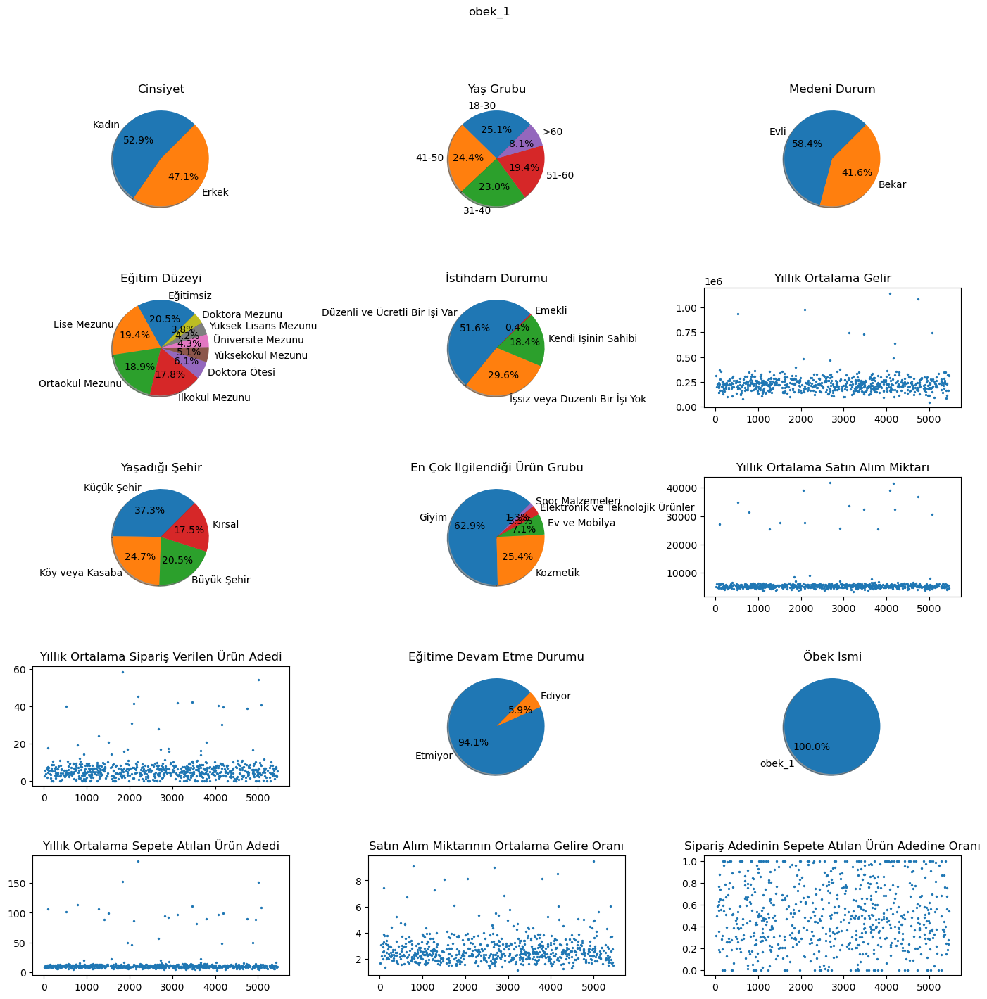

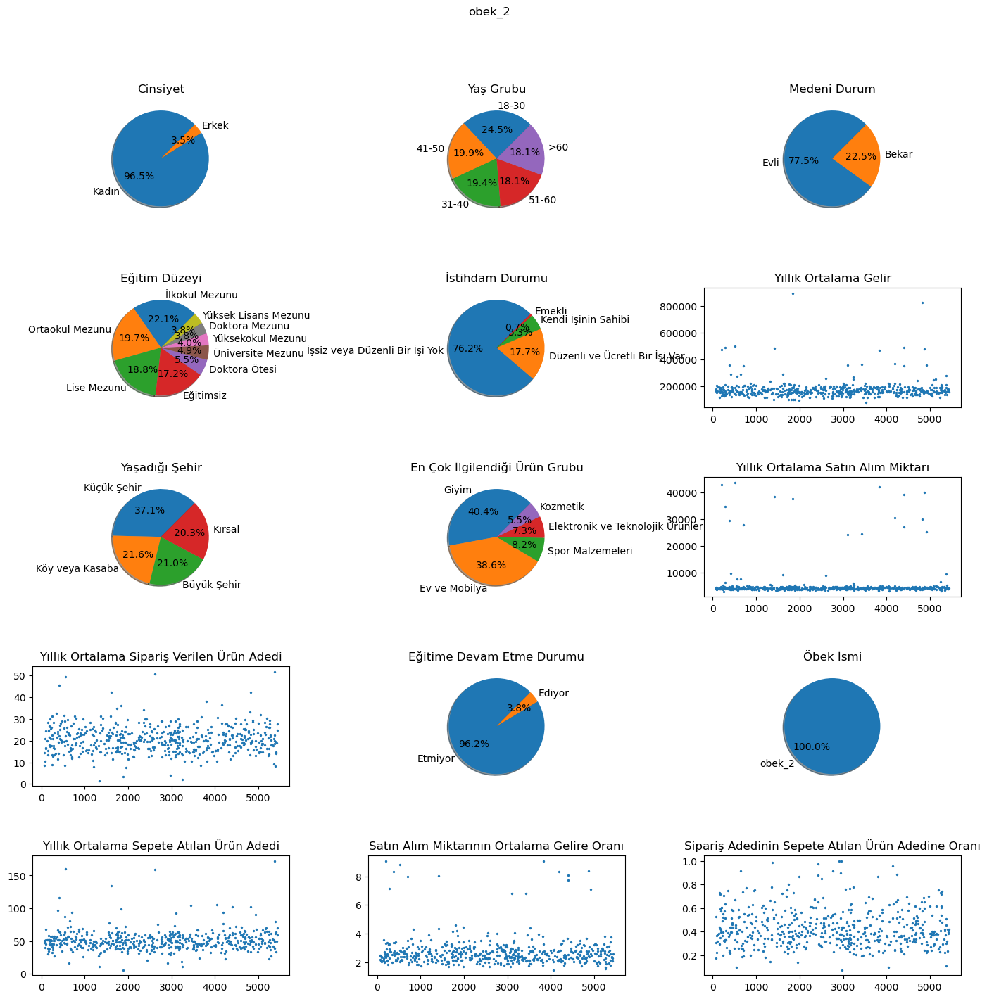

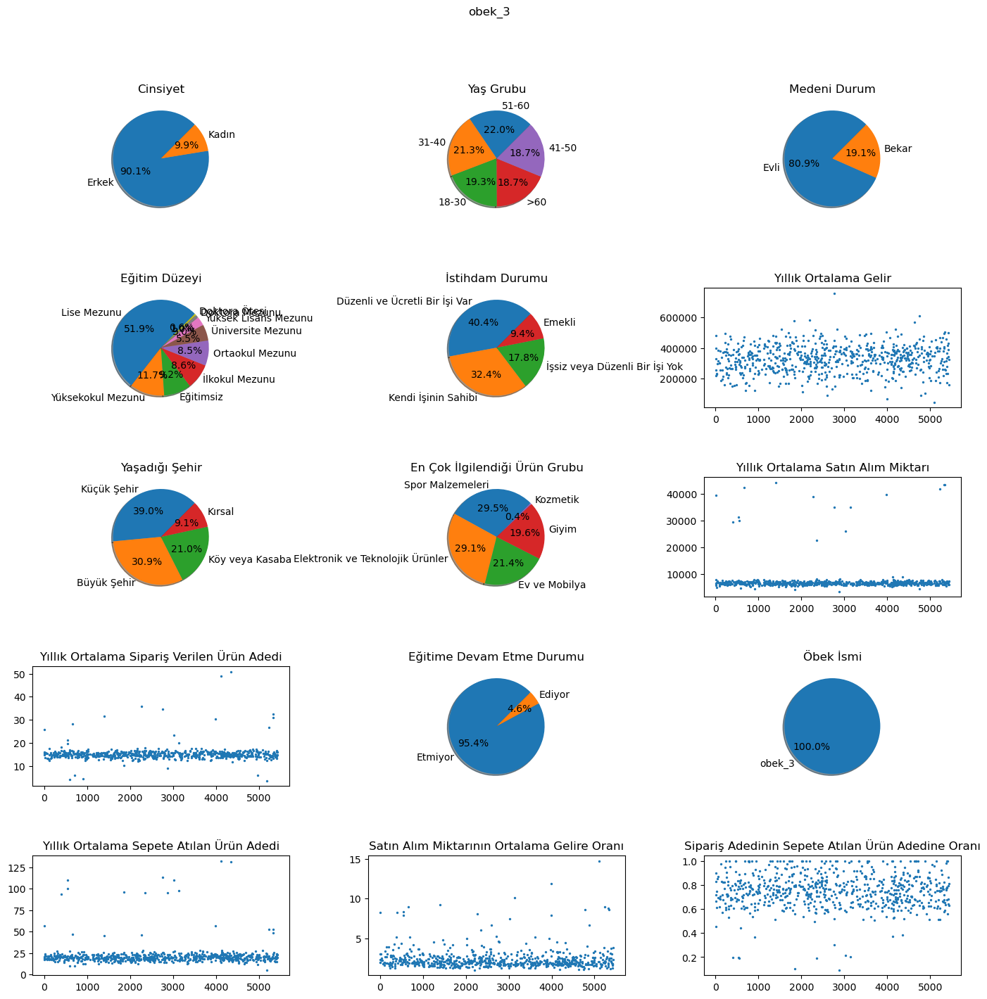

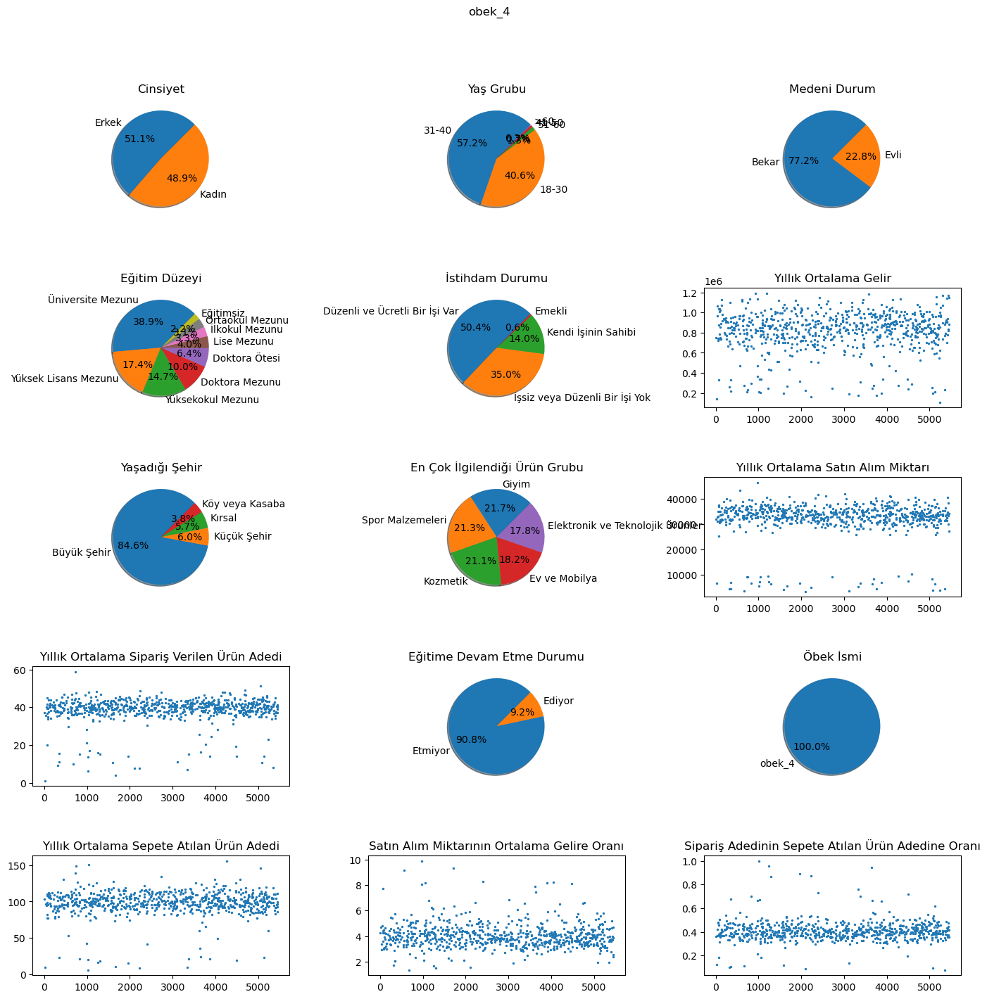

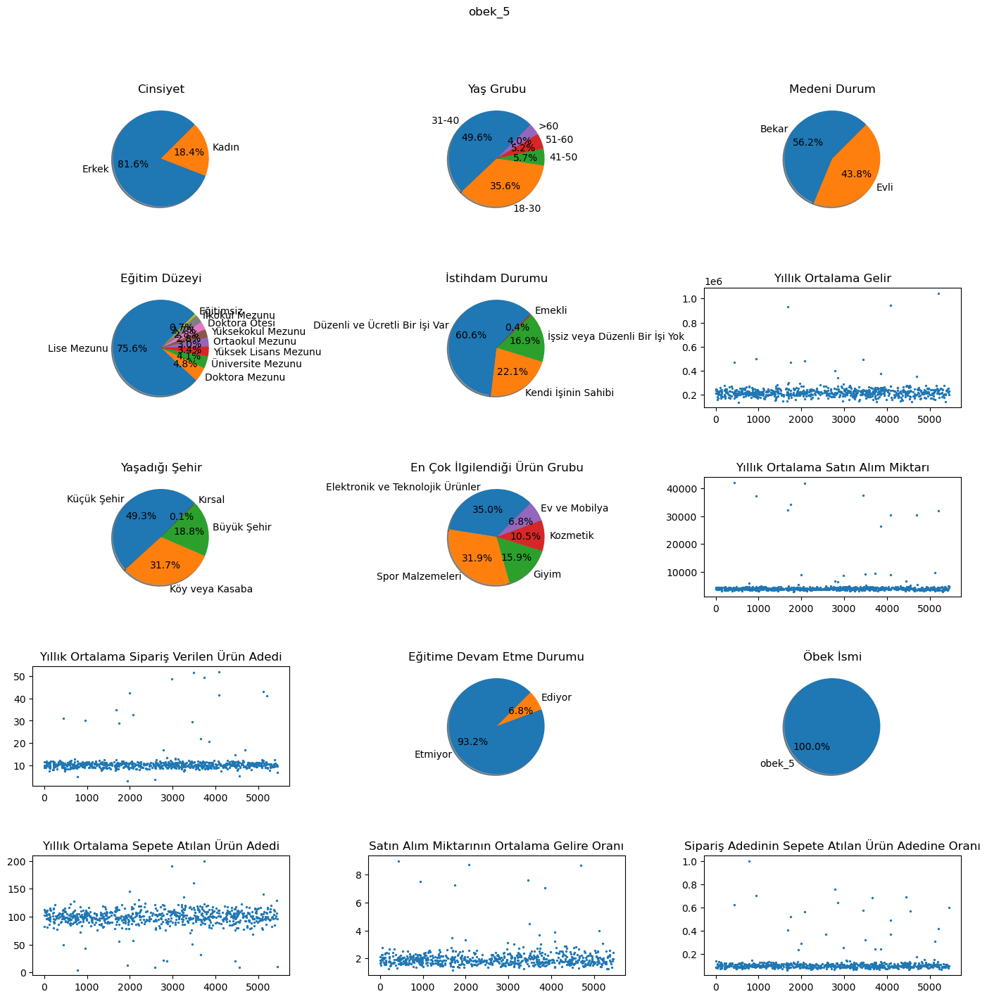

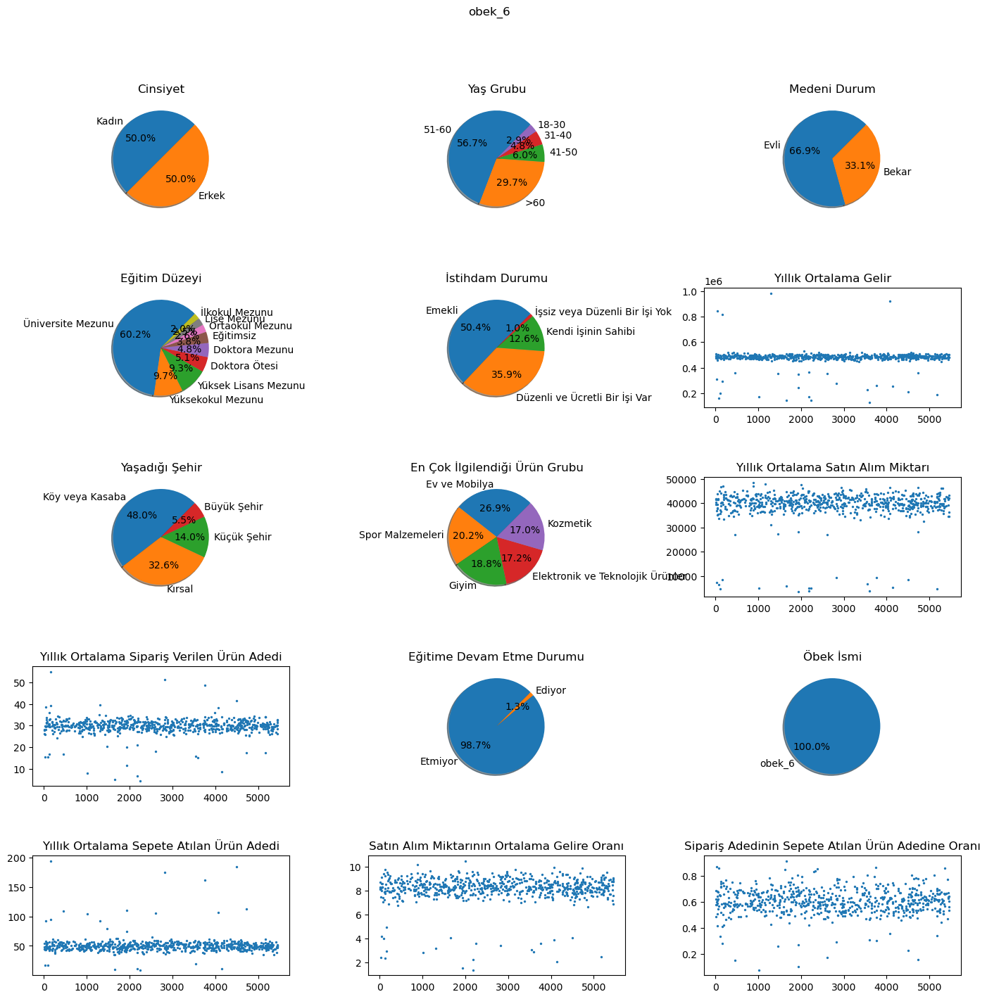

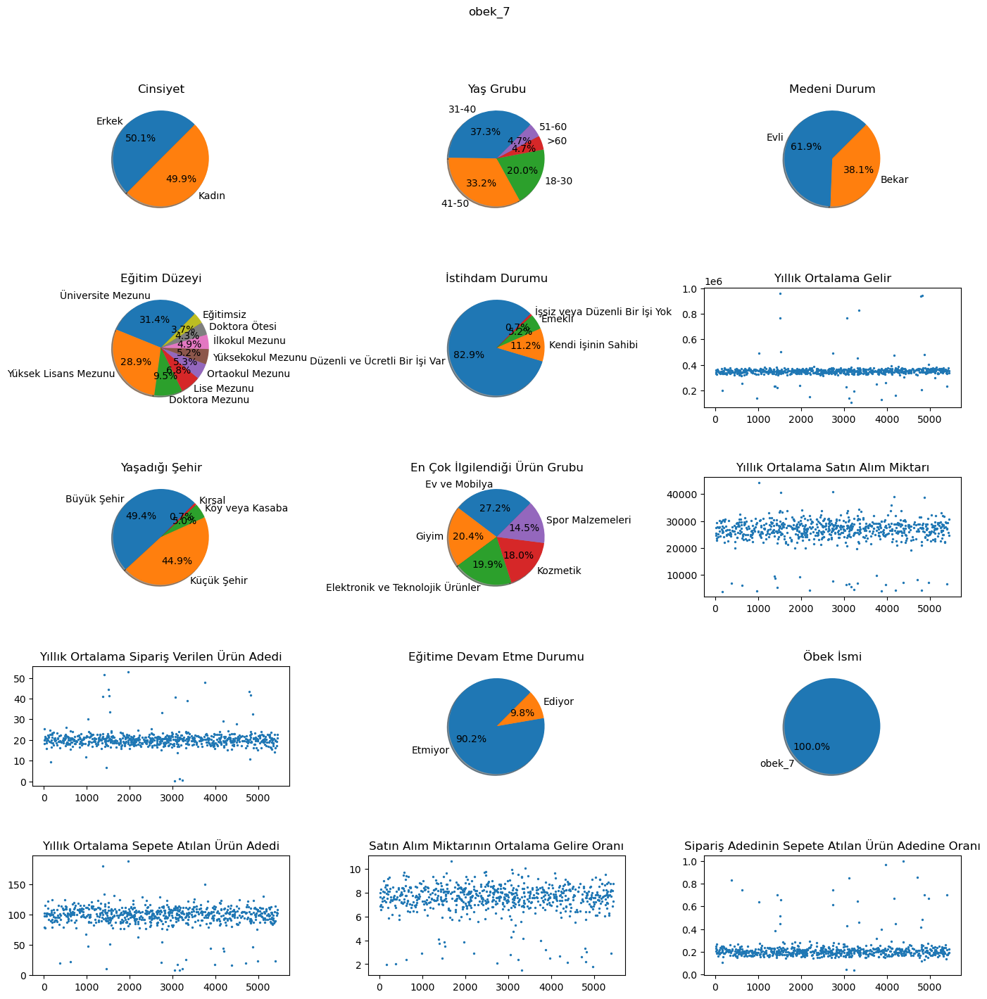

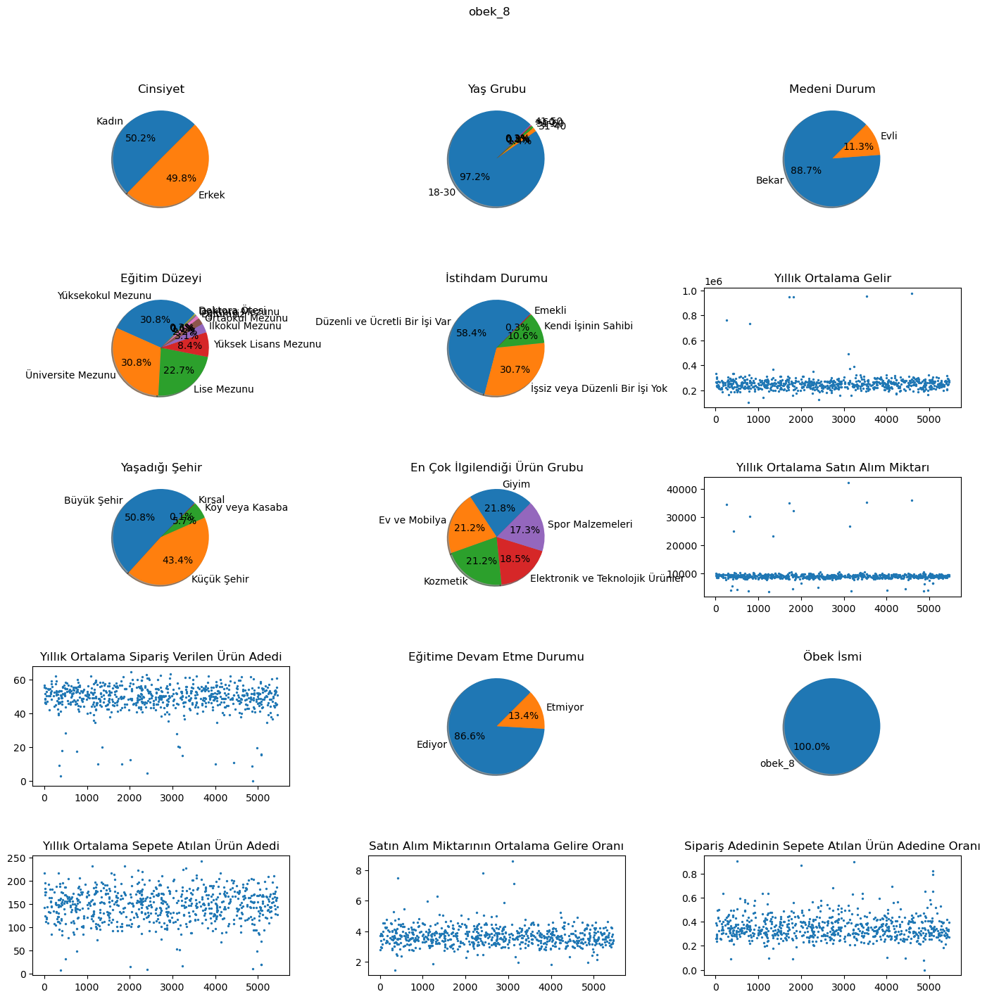

In [37]:
obeks = graph_df["Öbek İsmi"].unique()
obeks.sort()


for obek in obeks:
    visualize_this(graph_df[(graph_df["Öbek İsmi"] == obek)], obek)

In [38]:
for i in object_cols:
    look_for_columns =  object_cols.copy()
    look_for_columns.remove(i)

    for j in look_for_columns:
        crosscheck(df, j, i, info=False, plot=True)
        print("\n")
        
    print("*"*100)
    print("*"*100)    
    print("*"*100)
    print("\n")



****************************************************************************************************
****************************************************************************************************
****************************************************************************************************






****************************************************************************************************
****************************************************************************************************
****************************************************************************************************






****************************************************************************************************
****************************************************************************************************
****************************************************************************************************






****************************************************************************************************
****************************************************************************************************
****************************************************************************************************






****************************************************************************************************
****************************************************************************************************
****************************************************************************************************






****************************************************************************************************
****************************************************************************************************
****************************************************************************************************






****************************************************************************************************
****************************************************************************************************
****************************************************************************************************






****************************************************************************************************
****************************************************************************************************
****************************************************************************************************






****************************************************************************************************
****************************************************************************************************
****************************************************************************************************




# Öbek isimlendirmeleri ve anlamlandırmaları (30 Puan)

**Bu kısım Excel'dedir.**

# Veri İşleme & Özellik Mühendisliği (20 Puan)

## Aykırı Değerler & Anomali Tespiti

### Çeyrekler Açıklığı (IQR)

**IQR yöntemiyle atılacak veriler yok gibi gözüküyor. İncelemelerimizde verimizde tek başına kolonlara baktığımızda herhangi bir anormallik gözlemlenmiyor.**

In [39]:
num_summary(df, num_cols)

,count,mean,std,min,5%,10%,20%,30%,40%,50%,60%,70%,80%,90%,95%,99%,max
index,5460.0,2729.500000,1576.310566,0.000000,272.950000,545.900000,1091.800000,1637.700000,2183.600000,2729.500000,3275.400000,3821.300000,4367.200000,4913.100000,5186.050000,5.404410e+03,5.459000e+03
Yıllık Ortalama Gelir,5460.0,363571.133428,219714.442407,43922.988693,150628.727704,170575.367076,203289.880195,227446.347415,251775.806960,286925.436073,343822.097469,372797.396417,484246.153380,759080.731932,890884.524597,1.035737e+06,1.192437e+06
Yıllık Ortalama Satın Alım Miktarı,5460.0,16616.612217,14099.171704,2859.254000,3750.944992,3982.074933,4480.098785,5443.628646,6530.204868,8426.818967,9649.438113,27959.771488,33290.270684,38756.728396,41256.719718,4.402241e+04,4.860559e+04
Yıllık Ortalama Sipariş Verilen Ürün Adedi,5460.0,24.040884,14.945655,0.000000,4.012480,7.169551,10.321560,14.277608,16.356228,20.095924,26.176960,31.195390,39.760832,46.698859,51.775273,5.766360e+01,6.461620e+01
Yıllık Ortalama Sepete Atılan Ürün Adedi,5460.0,73.445693,47.214184,3.977559,9.478686,11.471611,20.334653,43.406962,51.719672,82.485579,94.814793,101.236289,108.553175,129.625888,159.470950,1.924694e+02,2.423084e+02


### Yerel Aykırı Değer Faktörü (LOF)

Tek başına kolonlarımızı incelediğimizde göze batan anormallikler olmasa bile birlikte incelendiğinde "18-30 yaşlarında olup emekli olan kişiler" gibi anormallik gösteren kolonlarımızı _LOF Algoritmasıyla_ tespit etmeye çalışıyoruz.

Burada algoritmanın bulduğu aykırı değerleri dataframemizden atarak tekrar temel modellerimizi eğiterek doğruluklarını gözlemleyeceğiz.


In [40]:
encod_df2 = X.copy()
encod_df2["Öbek İsmi"] = y

In [41]:
# LOF Algoritmamızla aykırı değerleri gözlemlemeye çalışıyoruz.

lof = LocalOutlierFactor()
lof.fit(encod_df2)
pred = lof.fit_predict(encod_df2)
pred

array([1, 1, 1, ..., 1, 1, 1])

In [42]:
# Kaç tane inlier kaç tane outlier verimiz var onları gözlemliyoruz.

np.unique(pred, return_counts=True)

(array([-1,  1]), array([  68, 5392]))

In [43]:
# Burada gerçekten göze çarpan aykırı değerleri bulmuş mu diye birkaç verimizi gözlemliyoruz.

df_with_inlier = df.copy()
df_with_inlier["inlier"] = pred
df_outlier = df_with_inlier[df_with_inlier['inlier'] == -1]
df_outlier

,index,Cinsiyet,Yaş Grubu,Medeni Durum,Eğitim Düzeyi,İstihdam Durumu,Yıllık Ortalama Gelir,Yaşadığı Şehir,En Çok İlgilendiği Ürün Grubu,Yıllık Ortalama Satın Alım Miktarı,Yıllık Ortalama Sipariş Verilen Ürün Adedi,Eğitime Devam Etme Durumu,Öbek İsmi,Yıllık Ortalama Sepete Atılan Ürün Adedi,inlier
155,155,Kadın,18-30,Bekar,Ortaokul Mezunu,İşsiz veya Düzenli Bir İşi Yok,189348.802058,Büyük Şehir,Elektronik ve Teknolojik Ürünler,9025.100309,52.240056,Ediyor,obek_8,154.036246,-1
184,184,Erkek,51-60,Evli,Üniversite Mezunu,Kendi İşinin Sahibi,494757.358828,Kırsal,Spor Malzemeleri,47177.288486,27.668891,Etmiyor,obek_6,54.719631,-1
204,204,Kadın,>60,Evli,Yüksek Lisans Mezunu,Emekli,487446.768615,Köy veya Kasaba,Ev ve Mobilya,33409.864716,26.208762,Etmiyor,obek_6,61.779529,-1
311,311,Erkek,18-30,Bekar,Yüksekokul Mezunu,İşsiz veya Düzenli Bir İşi Yok,166403.198497,Küçük Şehir,Kozmetik,8813.629018,51.030082,Ediyor,obek_8,111.491624,-1
358,358,Kadın,18-30,Evli,Yüksekokul Mezunu,Düzenli ve Ücretli Bir İşi Var,188104.232755,Küçük Şehir,Giyim,8850.791555,53.132764,Ediyor,obek_8,108.224484,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4999,4999,Kadın,18-30,Evli,Lise Mezunu,Düzenli ve Ücretli Bir İşi Var,43922.988693,Köy veya Kasaba,Kozmetik,4169.949102,2.934947,Etmiyor,obek_1,10.408325,-1
5100,5100,Erkek,18-30,Evli,Lise Mezunu,Düzenli ve Ücretli Bir İşi Var,45695.091498,Küçük Şehir,Spor Malzemeleri,6740.639692,15.557786,Ediyor,obek_3,16.284374,-1
5130,5130,Erkek,51-60,Bekar,Doktora Ötesi,Düzenli ve Ücretli Bir İşi Var,299549.793156,Büyük Şehir,Elektronik ve Teknolojik Ürünler,27327.309076,19.524385,Etmiyor,obek_7,103.867181,-1
5215,5215,Erkek,18-30,Bekar,Doktora Ötesi,İşsiz veya Düzenli Bir İşi Yok,548845.696664,Büyük Şehir,Spor Malzemeleri,31824.835159,40.085223,Etmiyor,obek_4,98.404522,-1


In [44]:
# Burada algoritmanın bulduğu aykırı değerleri encod edilmiş dataframemizde inceliyoruz.

df_with_inlier = encod_df2.copy()
df_with_inlier["inlier"] = pred
df_outlier = df_with_inlier[df_with_inlier['inlier'] == -1]
df_outlier

,index,Cinsiyet,Yaş Grubu,Medeni Durum,Eğitim Düzeyi,İstihdam Durumu,Yıllık Ortalama Gelir,Yaşadığı Şehir,En Çok İlgilendiği Ürün Grubu,Yıllık Ortalama Satın Alım Miktarı,Yıllık Ortalama Sipariş Verilen Ürün Adedi,Eğitime Devam Etme Durumu,Yıllık Ortalama Sepete Atılan Ürün Adedi,Öbek İsmi,inlier
155,155,1.0,0.0,0.0,4.0,3.0,189348.802058,0.0,0.0,9025.100309,52.240056,0.0,154.036246,7,-1
184,184,0.0,3.0,1.0,7.0,2.0,494757.358828,3.0,4.0,47177.288486,27.668891,1.0,54.719631,5,-1
204,204,1.0,4.0,1.0,5.0,1.0,487446.768615,1.0,1.0,33409.864716,26.208762,1.0,61.779529,5,-1
311,311,0.0,0.0,0.0,6.0,3.0,166403.198497,2.0,3.0,8813.629018,51.030082,0.0,111.491624,7,-1
358,358,1.0,0.0,1.0,6.0,0.0,188104.232755,2.0,2.0,8850.791555,53.132764,0.0,108.224484,7,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4999,4999,1.0,0.0,1.0,3.0,0.0,43922.988693,1.0,3.0,4169.949102,2.934947,1.0,10.408325,0,-1
5100,5100,0.0,0.0,1.0,3.0,0.0,45695.091498,2.0,4.0,6740.639692,15.557786,0.0,16.284374,2,-1
5130,5130,0.0,3.0,0.0,1.0,0.0,299549.793156,0.0,0.0,27327.309076,19.524385,1.0,103.867181,6,-1
5215,5215,0.0,0.0,0.0,1.0,3.0,548845.696664,0.0,4.0,31824.835159,40.085223,1.0,98.404522,3,-1


In [45]:
# dataframemizden aykırı değerleri atıyoruz.

df_with_inlier = df_with_inlier.drop(index=df_outlier.index)
df_with_inlier.shape # 5460 - 68 = 5392

(5392, 15)

Tekrar temel modellerimizi outlier değerler olmadan deniyoruz.

In [46]:
lof_y = df_with_inlier["Öbek İsmi"]

X = df_with_inlier.copy()
X.drop(["Öbek İsmi"], axis=1, inplace=True) # tüm verilerimizden hedef kolonumuzu çıkarıyoruz.

In [47]:
# Deneyeceğimiz algoritmalarımızı hızlıca yazdığımız fonksiyonumuzla;
# Liste şeklinde kıyaslama yapacağımız modellerimizi ve tüm verilerimizi alarak
# 3 çapraz doğrulama oluşturup modellerin doğruluklarını gözlemliyoruz.

model_list = [
    
    LogisticRegression(multi_class='multinomial', random_state=1, solver="newton-cg"), # 0
    
    KNeighborsClassifier(n_neighbors=3), # 1
    
    DecisionTreeClassifier(), # 2
    
    RandomForestClassifier(), # 3
    
    ExtraTreesClassifier(), # 4
    
    HistGradientBoostingClassifier(), # 5
    
    VotingClassifier(estimators=[('lr', LogisticRegression(multi_class='multinomial', random_state=1)),
                                 ('rf', RandomForestClassifier()),
                                 ('dtc', DecisionTreeClassifier())],
                                 voting='hard'), # 6
    
    LGBMClassifier(), # 7
    
    CatBoostClassifier(iterations=1000, task_type="GPU", verbose=0) # 8
]

fast_model_select(model_list, X, lof_y)

Model 0 Accuracy: %82.73586204007874
Model 1 Accuracy: %79.8964986962781
Model 2 Accuracy: %73.48089109088623
Model 3 Accuracy: %95.47484591486366
Model 4 Accuracy: %95.43774704637914
Model 5 Accuracy: %93.43457321548355
Model 6 Accuracy: %90.96795239625058
Model 7 Accuracy: %92.61867665983908
Model 8 Accuracy: %95.14095609850307


**Önceki Temel Model Doğruluk Skorlarımız (random_state kullanılmadığı için kodlar koşturulunca farklılık gösterebilir.)**

* Model 0 Accuracy: %83.51648351648352
* Model 1 Accuracy: %79.7802197802198
* Model 2 Accuracy: %70.03663003663004
* Model 3 Accuracy: %95.47619047619048
* Model 4 Accuracy: %95.45787545787546

* Model 5 Accuracy: %92.82051282051282
* Model 6 Accuracy: %90.2014652014652
* Model 7 Accuracy: %92.63736263736263
* Model 8 Accuracy: %94.85347985347984

**Bölüm Yorumu (Aykırı Değerler & Anomali Tespiti)**

* Aykırı değerleri çıkarmak modellerimizde küçük artı ve eksi oynamalara sebep oldu.

* Verilerimizi pürüsüzleştirdiğimiz halde kayda değer bir yükselme yakalayamadık.

* Submission verilerinde de outlier değerler olabileceğini düşünüyoruz (olsa da olmasa da doğruluğumuz değişmeyecek bu gözlemlerden çıkardığımız sonuçlarla).

* Submission verilerinde aykırı değerleri yakalamamız daha çok zorlaşacağı için LOF kullanmanın bu veriseti için mantıksız olduğu gözlemlenmiştir.


## Özellik Mühendisliği

Özellikler eklenerek modeller yeni özelliklerle tekrar eğitilerek gözlemlenecektir. Özelliklerin modelleri nasıl etkilediği gözlemlenecektir.

Aşağıdaki fonksiyonları fonksiyonlar kısmına yazmamamızın sebebi yalnızca verisetine özellik eklemeyi kolaylaştırması için yazıldığındandır. (Sebepleriyle birlikte ek açıklamalar eklenecektir.)

In [48]:
def round_feature(df):
    
    ##############################################################################
    # Yaş Grubu
    kosullar = [
        (df['Yaş Grubu'] == '18-30') | (df['Yaş Grubu'] == '31-40'),
        (df['Yaş Grubu'] == '41-50') | (df['Yaş Grubu'] == '51-60'),
        (df['Yaş Grubu'] == '>60')
    ]
    degerler = [
        1,
        2,
        3
    ]

    # Dataframe'e Bölge adlı yeni bir kolon ekleyelim
    df['Yaş Durumu'] = np.select(kosullar, degerler, default='Belirtilmedi')
    
    ##############################################################################
    # Eğitim Düzeyi
        # Koşulları ve değerleri listeler halinde tanımlayalım
    kosullar = [
        (df['Eğitim Düzeyi'] == 'Eğitimsiz') | (df['Eğitim Düzeyi'] == 'İlkokul Mezunu') | (df['Eğitim Düzeyi'] == 'Ortaokul Mezunu'),
        (df['Eğitim Düzeyi'] == 'Lise Mezunu') | (df['Eğitim Düzeyi'] == 'Yüksekokul Mezunu'),
        (df['Eğitim Düzeyi'] == 'Üniversite Mezunu') | (df['Eğitim Düzeyi'] == 'Yüksek Lisans Mezunu'),
        (df['Eğitim Düzeyi'] == 'Doktora Mezunu') | (df['Eğitim Düzeyi'] == 'Doktora Ötesi')
    ]
    degerler = [
        1,
        2,
        3,
        4
    ]

    # Dataframe'e Bölge adlı yeni bir kolon ekleyelim
    df['Eğitim Durumu'] = np.select(kosullar, degerler, default='Belirtilmedi')
    
    ##############################################################################
    # Yaşadığı Şehir
    kosullar = [
        (df['Yaşadığı Şehir'] == 'Köy veya Kasaba') | (df['Yaşadığı Şehir'] == 'Kırsal'),
        (df['Yaşadığı Şehir'] == 'Küçük Şehir') | (df['Yaşadığı Şehir'] == 'Büyük Şehir'),

    ]
    degerler = [
        1,
        2
    ]

    # Dataframe'e Bölge adlı yeni bir kolon ekleyelim
    df['Yaşadığı Şehir Durumu'] = np.select(kosullar, degerler, default='Belirtilmedi')
    
    ##############################################################################
    # Yıllık Ortalama Gelir
    kosullar = [
        (df['Yıllık Ortalama Gelir'] <= 120000),
        (df['Yıllık Ortalama Gelir'] > 120000) & (df['Yıllık Ortalama Gelir'] <= 300000),
        (df['Yıllık Ortalama Gelir'] > 300000) & (df['Yıllık Ortalama Gelir'] <= 500000),
        (df['Yıllık Ortalama Gelir'] > 500000)
    ]
    degerler = [
        1,
        2,
        3,
        4
    ]

    # Dataframe'e Bölge adlı yeni bir kolon ekleyelim
    df['Yıllık Ortalama Gelir Durumu'] = np.select(kosullar, degerler, default='Belirtilmedi')
    
    ##############################################################################
    # Yıllık Ortalama Satın Alım Miktarı
    kosullar = [
        (df['Yıllık Ortalama Satın Alım Miktarı'] <= 8500),
        (df['Yıllık Ortalama Satın Alım Miktarı'] > 8500) & (df['Yıllık Ortalama Satın Alım Miktarı'] <= 20000),
        (df['Yıllık Ortalama Satın Alım Miktarı'] > 20000)
    ]
    degerler = [
        1,
        2,
        3

    ]

    # Dataframe'e Bölge adlı yeni bir kolon ekleyelim
    df['Yıllık Ortalama Satın Alım Durumu'] = np.select(kosullar, degerler, default='Belirtilmedi')
    
    ##############################################################################
    # Yıllık Ortalama Sipariş Verilen Ürün Adedi
    kosullar = [
        (df['Yıllık Ortalama Sipariş Verilen Ürün Adedi'] <= 5),
        (df['Yıllık Ortalama Sipariş Verilen Ürün Adedi'] > 5) & (df['Yıllık Ortalama Sipariş Verilen Ürün Adedi'] <= 35),
        (df['Yıllık Ortalama Sipariş Verilen Ürün Adedi'] > 35)
    ]
    degerler = [
        1,
        2,
        3
    ]

    ##############################################################################
    # Yıllık Ortalama Sipariş Verilen Ürün Adedi
        # Dataframe'e Bölge adlı yeni bir kolon ekleyelim
    df['Yıllık Ortalama Sipariş Verilen Ürün Adedi Durumu'] = np.select(kosullar, degerler, default='Belirtilmedi')

        # Koşulları ve değerleri listeler halinde tanımlayalım
    kosullar = [
        (df['Yıllık Ortalama Sepete Atılan Ürün Adedi'] <= 25),
        (df['Yıllık Ortalama Sepete Atılan Ürün Adedi'] > 25) & (df['Yıllık Ortalama Sepete Atılan Ürün Adedi'] <= 60),
        (df['Yıllık Ortalama Sepete Atılan Ürün Adedi'] > 60) & (df['Yıllık Ortalama Sepete Atılan Ürün Adedi'] <= 100),
        (df['Yıllık Ortalama Sepete Atılan Ürün Adedi'] > 100)
    ]
    degerler = [
        1,
        2,
        3,
        4
    ]

    # Dataframe'e Bölge adlı yeni bir kolon ekleyelim
    df['Yıllık Ortalama Sepete Alınan Ürün Adedi Durumu'] = np.select(kosullar, degerler, default='Belirtilmedi')
    
    
    return df

In [49]:
def ratio_feature(df):
    
    df["Satın Alım Miktarının Ortalama Gelire Oranı"] = (df["Yıllık Ortalama Satın Alım Miktarı"] * 100) / df["Yıllık Ortalama Gelir"]

    df["Sipariş Adedinin Sepete Atılan Ürün Adedine Oranı"] = (df["Yıllık Ortalama Sipariş Verilen Ürün Adedi"]) / df["Yıllık Ortalama Sepete Atılan Ürün Adedi"]
    
    return df


In [50]:
# iki farklılığa bakılarak oluşturulan fonksiyonlardan üretilen verileri ayrı ayrı değerlendireceğimiz için
# birbirlerini ezdirmeden copy() fonksiyonuyla yeni df'ler oluşturarak özelliklerimizi ekledik.

add_round_feature_df = df.copy()
add_round_feature_df = round_feature(add_round_feature_df)

add_randr_feature_df = add_round_feature_df.copy()
add_randr_feature_df = ratio_feature(add_randr_feature_df)

print(f"df.shape: {df.shape}\nadd_round_feature_df.shape: {add_round_feature_df.shape}\nadd_randr_feature_df: {add_randr_feature_df.shape}")

df.shape: (5460, 14)
add_round_feature_df.shape: (5460, 21)
add_randr_feature_df: (5460, 23)


In [51]:
add_round_feature_df

,index,Cinsiyet,Yaş Grubu,Medeni Durum,Eğitim Düzeyi,İstihdam Durumu,Yıllık Ortalama Gelir,Yaşadığı Şehir,En Çok İlgilendiği Ürün Grubu,Yıllık Ortalama Satın Alım Miktarı,...,Eğitime Devam Etme Durumu,Öbek İsmi,Yıllık Ortalama Sepete Atılan Ürün Adedi,Yaş Durumu,Eğitim Durumu,Yaşadığı Şehir Durumu,Yıllık Ortalama Gelir Durumu,Yıllık Ortalama Satın Alım Durumu,Yıllık Ortalama Sipariş Verilen Ürün Adedi Durumu,Yıllık Ortalama Sepete Alınan Ürün Adedi Durumu
0,0,Kadın,31-40,Bekar,Yüksek Lisans Mezunu,Düzenli ve Ücretli Bir İşi Var,748266.440879,Büyük Şehir,Elektronik ve Teknolojik Ürünler,32010.900881,...,Etmiyor,obek_4,102.936904,1,3,2,4,3,3,4
1,1,Erkek,>60,Evli,Lise Mezunu,Kendi İşinin Sahibi,246298.609605,Küçük Şehir,Spor Malzemeleri,4145.729891,...,Etmiyor,obek_5,82.176053,3,2,2,2,1,2,3
2,2,Erkek,18-30,Bekar,Lise Mezunu,Düzenli ve Ücretli Bir İşi Var,268582.732360,Küçük Şehir,Giyim,9924.379414,...,Ediyor,obek_8,141.661426,1,2,2,2,2,3,4
3,3,Erkek,51-60,Evli,Lise Mezunu,Kendi İşinin Sahibi,327721.837865,Kırsal,Giyim,6417.780714,...,Etmiyor,obek_3,17.097397,2,2,1,3,1,2,1
4,4,Erkek,31-40,Evli,Ortaokul Mezunu,İşsiz veya Düzenli Bir İşi Yok,397431.626948,Büyük Şehir,Giyim,7886.663061,...,Etmiyor,obek_3,20.470459,1,1,2,3,1,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5455,5455,Kadın,>60,Bekar,Üniversite Mezunu,Emekli,478054.247819,Köy veya Kasaba,Kozmetik,43182.299801,...,Etmiyor,obek_6,51.600436,3,3,1,3,3,2,2
5456,5456,Erkek,51-60,Evli,Doktora Ötesi,Kendi İşinin Sahibi,481852.853651,Köy veya Kasaba,Ev ve Mobilya,42107.996193,...,Etmiyor,obek_6,49.190536,2,4,1,3,3,2,2
5457,5457,Kadın,51-60,Evli,İlkokul Mezunu,Düzenli ve Ücretli Bir İşi Var,309443.687351,Küçük Şehir,Ev ve Mobilya,4655.392445,...,Etmiyor,obek_1,9.537384,2,1,2,3,1,2,1
5458,5458,Kadın,18-30,Bekar,Yüksekokul Mezunu,Düzenli ve Ücretli Bir İşi Var,266604.268016,Büyük Şehir,Ev ve Mobilya,9016.165906,...,Ediyor,obek_8,143.281718,1,2,2,2,2,3,4


In [52]:
def revise_X(df):
    # özniteliklerimizi belirleyelim.
    X = df.copy()
    X.drop(["Öbek İsmi"], axis=1, inplace=True) # tüm verilerimizden hedef kolonumuzu çıkarıyoruz.

    object_cols, d = calc_object_cols(X, 0)

    ordinal_encoder = OrdinalEncoder()
    X[object_cols] = ordinal_encoder.fit_transform(X[object_cols])

    return X

In [53]:
X = revise_X(add_round_feature_df)

In [54]:
# Deneyeceğimiz algoritmalarımızı hızlıca yazdığımız fonksiyonumuzla;
# Liste şeklinde kıyaslama yapacağımız modellerimizi ve tüm verilerimizi alarak
# 3 çapraz doğrulama oluşturup modellerin doğruluklarını gözlemliyoruz.

model_list = [
    
    LogisticRegression(multi_class='multinomial', random_state=1, solver="newton-cg"), # 0
    
    KNeighborsClassifier(n_neighbors=3), # 1
    
    DecisionTreeClassifier(), # 2
    
    RandomForestClassifier(), # 3
    
    ExtraTreesClassifier(), # 4
    
    HistGradientBoostingClassifier(), # 5
    
    VotingClassifier(estimators=[('lr', LogisticRegression(multi_class='multinomial', random_state=1)),
                                 ('rf', RandomForestClassifier()),
                                 ('dtc', DecisionTreeClassifier())],
                                 voting='hard'), # 6
    
    LGBMClassifier(), # 7
    
    CatBoostClassifier(iterations=1000, task_type="GPU", verbose=0) # 8
]

fast_model_select(model_list, X, y)

Model 0 Accuracy: %83.42490842490842
Model 1 Accuracy: %79.7802197802198
Model 2 Accuracy: %72.36263736263736
Model 3 Accuracy: %95.47619047619048
Model 4 Accuracy: %95.40293040293041
Model 5 Accuracy: %92.49084249084248
Model 6 Accuracy: %91.26373626373626
Model 7 Accuracy: %93.003663003663
Model 8 Accuracy: %94.89010989010987


In [55]:
X2 = revise_X(add_randr_feature_df)
fast_model_select(model_list, X2, y)

Model 0 Accuracy: %83.22344322344323
Model 1 Accuracy: %79.7802197802198
Model 2 Accuracy: %70.91575091575092
Model 3 Accuracy: %95.42124542124543
Model 4 Accuracy: %95.40293040293041
Model 5 Accuracy: %93.36996336996336
Model 6 Accuracy: %88.68131868131867
Model 7 Accuracy: %93.33333333333333
Model 8 Accuracy: %94.83516483516482


**Önceki Temel Model Doğruluk Skorlarımız (random_state kullanılmadığı için kodlar koşturulunca farklılık gösterebilir.)**

* Model 0 Accuracy: %83.51648351648352
* Model 1 Accuracy: %79.7802197802198
* Model 2 Accuracy: %70.03663003663004
* Model 3 Accuracy: %95.47619047619048
* Model 4 Accuracy: %95.45787545787546

* Model 5 Accuracy: %92.82051282051282
* Model 6 Accuracy: %90.2014652014652
* Model 7 Accuracy: %92.63736263736263
* Model 8 Accuracy: %94.85347985347984

Modelimizde özelliklerin ne kadar etki sağladığını gözlemleyelim.

In [56]:
# Verilerimizi train ve validation olarak ayırıyoruz.
X_train, X_valid, y_train, y_valid = train_test_split(X, y, train_size=0.8, test_size=0.2, random_state=0)

In [57]:
# Make a small change to the code below to use in this problem. 
perm = PermutationImportance(RandomForestClassifier().fit(X_train, y_train), random_state=1).fit(X_valid, y_valid)

# uncomment the following line to visualize your results
eli5.show_weights(perm, feature_names = X_valid.columns.tolist())

Weight,Feature
0.1366 ± 0.0083,Yıllık Ortalama Sipariş Verilen Ürün Adedi
0.0474 ± 0.0071,Yıllık Ortalama Sepete Atılan Ürün Adedi
0.0187 ± 0.0038,Yıllık Ortalama Gelir
0.0016 ± 0.0027,Yıllık Ortalama Satın Alım Miktarı
0.0005 ± 0.0009,Cinsiyet
0.0005 ± 0.0009,Yıllık Ortalama Sepete Alınan Ürün Adedi Durumu
0 ± 0.0000,Yaş Durumu
0 ± 0.0000,Eğitim Durumu
0 ± 0.0000,Eğitime Devam Etme Durumu
0 ± 0.0000,Yaşadığı Şehir Durumu


<Axes: >

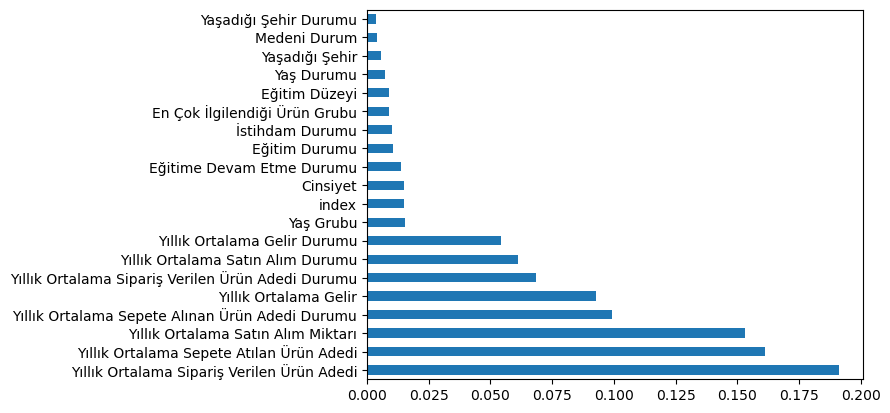

In [58]:
feat_importances = pd.Series(RandomForestClassifier().fit(X_train, y_train).feature_importances_,
                             index=X.columns)

feat_importances.nlargest(20).plot(kind='barh')

Değişkenlerin sahip oldukları veri gruplarının yakınlıklarından dolayı belli sınıflara ayrılarak özellik çıkarımı yapılmıştır.

# Model Seçimi (İstifleme & Topluluk Modelleri) (20 Puan)

Burada hangi modelin hangi sınıfları daha doğru sınıflandırdıklarını ve genel itibariyle nasıl bir sınıflandırma yaptıklarını gözlemleyerek, modelleri birlikte veya ayrı kullanacağımıza karar vereceğiz. Birbirlerine göre bazı sınıfları daha doğru sınıflandıran algoritmalar olursa o sınıflandırmaları yaptıklarında sonuçların oraya doğru yönelmesi için gerekirse ağırlık vereceğimiz bir düzen oluşturacağız.

 Toplam Doğruluk: % 90.25402752523321


,label,TruePredsPercent,Sum,true,false,most_frec
0,obek_1,0.798450,129,103,26,obek_1
1,obek_2,0.741071,112,83,29,obek_2
2,obek_3,0.928571,126,117,9,obek_3
3,obek_4,0.933333,150,140,10,obek_4
4,obek_5,0.964286,140,135,5,obek_5
5,obek_6,0.958333,144,138,6,obek_6
6,obek_7,0.954248,153,146,7,obek_7
7,obek_8,0.942029,138,130,8,obek_8


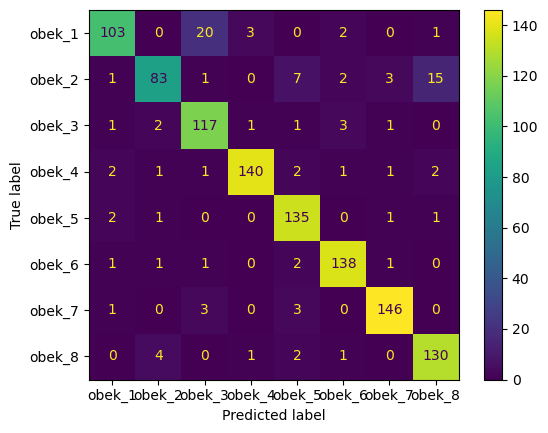

In [59]:
# LogisticRegression (LR)
model_fit_and_predict(LogisticRegression(multi_class='multinomial', random_state=1, solver="newton-cg"), y_label, X_train, y_train, X_valid, y_valid)

 Toplam Doğruluk: % 81.00457816679081


,label,TruePredsPercent,Sum,true,false,most_frec
0,obek_1,0.720930,129,93,36,obek_1
1,obek_2,0.687500,112,77,35,obek_2
2,obek_3,0.698413,126,88,38,obek_3
3,obek_4,0.933333,150,140,10,obek_4
4,obek_5,0.685714,140,96,44,obek_5
5,obek_6,0.944444,144,136,8,obek_6
6,obek_7,0.947712,153,145,8,obek_7
7,obek_8,0.862319,138,119,19,obek_8


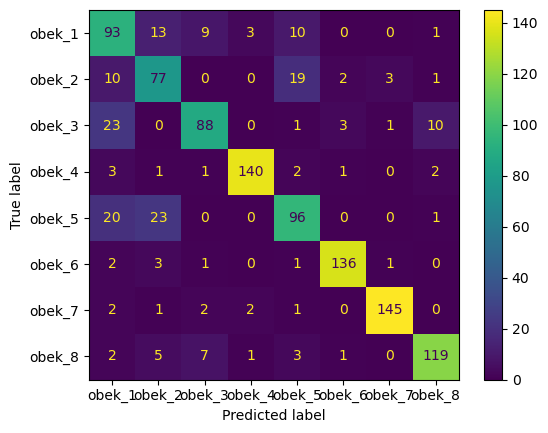

In [60]:
# KNeighborsClassifier (KNN)
model_fit_and_predict(KNeighborsClassifier(n_neighbors=3), y_label, X_train, y_train, X_valid, y_valid)

 Toplam Doğruluk: % 90.77441595529348


,label,TruePredsPercent,Sum,true,false,most_frec
0,obek_1,0.961240,129,124,5,obek_1
1,obek_2,0.910714,112,102,10,obek_2
2,obek_3,0.865079,126,109,17,obek_3
3,obek_4,0.900000,150,135,15,obek_4
4,obek_5,0.935714,140,131,9,obek_5
5,obek_6,0.909722,144,131,13,obek_6
6,obek_7,0.895425,153,137,16,obek_7
7,obek_8,0.884058,138,122,16,obek_8


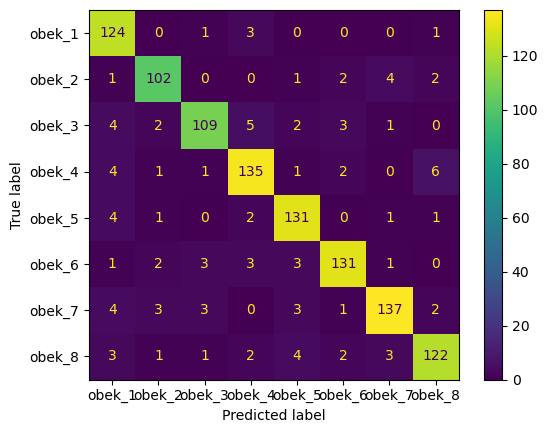

In [61]:
# DecisionTreeClassifier (DTC)
model_fit_and_predict(DecisionTreeClassifier(), y_label, X_train, y_train, X_valid, y_valid)

 Toplam Doğruluk: % 95.4961662496141


,label,TruePredsPercent,Sum,true,false,most_frec
0,obek_1,0.961240,129,124,5,obek_1
1,obek_2,0.937500,112,105,7,obek_2
2,obek_3,0.960317,126,121,5,obek_3
3,obek_4,0.940000,150,141,9,obek_4
4,obek_5,0.964286,140,135,5,obek_5
5,obek_6,0.958333,144,138,6,obek_6
6,obek_7,0.954248,153,146,7,obek_7
7,obek_8,0.963768,138,133,5,obek_8


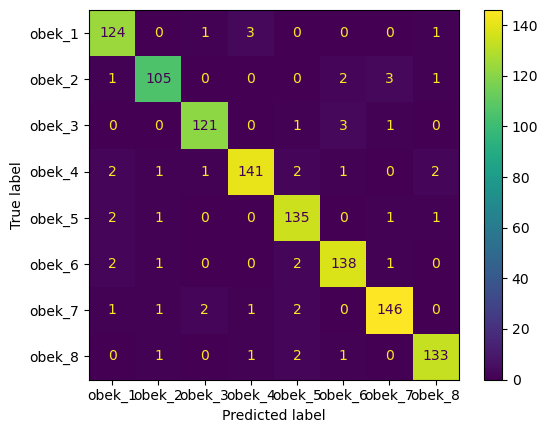

In [62]:
# RandomForestClassifier (RFC)
model_fit_and_predict(RandomForestClassifier(), y_label, X_train, y_train, X_valid, y_valid)

 Toplam Doğruluk: % 95.41283291628078


,label,TruePredsPercent,Sum,true,false,most_frec
0,obek_1,0.961240,129,124,5,obek_1
1,obek_2,0.937500,112,105,7,obek_2
2,obek_3,0.960317,126,121,5,obek_3
3,obek_4,0.933333,150,140,10,obek_4
4,obek_5,0.964286,140,135,5,obek_5
5,obek_6,0.958333,144,138,6,obek_6
6,obek_7,0.954248,153,146,7,obek_7
7,obek_8,0.963768,138,133,5,obek_8


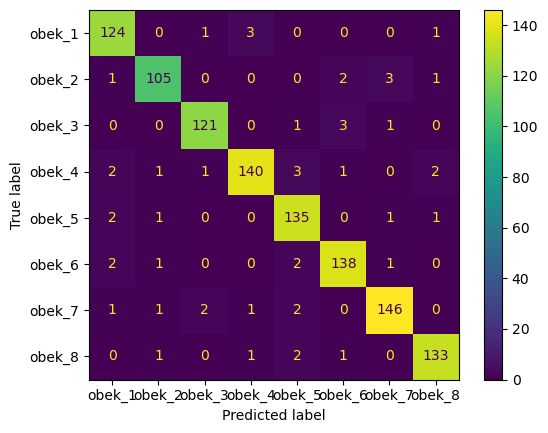

In [63]:
# ExtraTreesClassifier (ETC)
model_fit_and_predict(ExtraTreesClassifier(), y_label, X_train, y_train, X_valid, y_valid)

[Voting] ....................... (1 of 3) Processing lr, total=   0.3s
[Voting] ..................... (2 of 3) Processing lgbm, total=   1.2s
[Voting] ..................... (3 of 3) Processing catb, total=  15.8s
 Toplam Doğruluk: % 95.4961662496141


,label,TruePredsPercent,Sum,true,false,most_frec
0,obek_1,0.961240,129,124,5,obek_1
1,obek_2,0.937500,112,105,7,obek_2
2,obek_3,0.960317,126,121,5,obek_3
3,obek_4,0.940000,150,141,9,obek_4
4,obek_5,0.964286,140,135,5,obek_5
5,obek_6,0.958333,144,138,6,obek_6
6,obek_7,0.954248,153,146,7,obek_7
7,obek_8,0.963768,138,133,5,obek_8


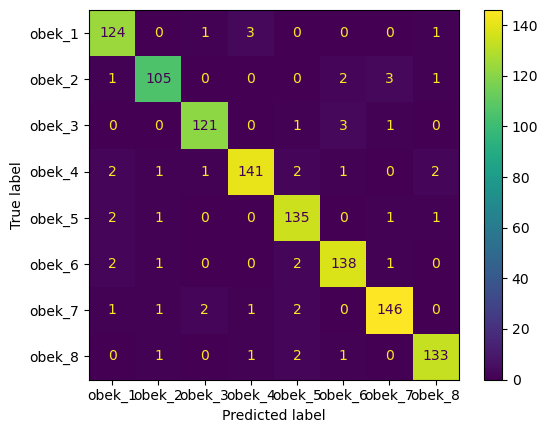

In [64]:
# VotingClassifier (VC)
clf1 = RandomForestClassifier(n_estimators=50, random_state=1)
clf2 = LGBMClassifier()
clf3 = CatBoostClassifier(iterations=3500, task_type="GPU", verbose=0)

eclf1 = VotingClassifier(estimators=[('lr', clf1), ('lgbm', clf2), ('catb', clf3)], voting='soft', verbose=True)

model_fit_and_predict(eclf1, y_label, X_train, y_train, X_valid, y_valid)

 Toplam Doğruluk: % 95.41283291628078


,label,TruePredsPercent,Sum,true,false,most_frec
0,obek_1,0.961240,129,124,5,obek_1
1,obek_2,0.937500,112,105,7,obek_2
2,obek_3,0.960317,126,121,5,obek_3
3,obek_4,0.933333,150,140,10,obek_4
4,obek_5,0.964286,140,135,5,obek_5
5,obek_6,0.958333,144,138,6,obek_6
6,obek_7,0.954248,153,146,7,obek_7
7,obek_8,0.963768,138,133,5,obek_8


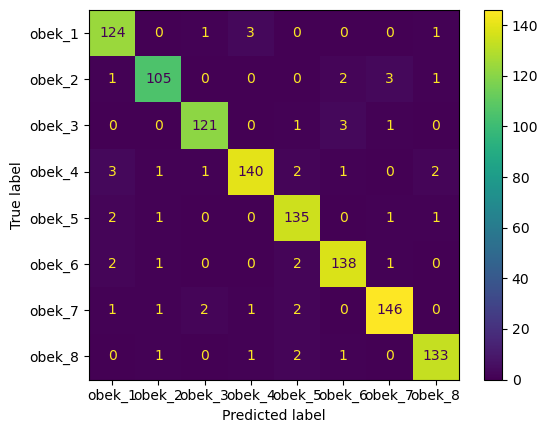

In [65]:
# LGBMClassifier (LGBM)
model_fit_and_predict(LGBMClassifier(), y_label, X_train, y_train, X_valid, y_valid)

 Toplam Doğruluk: % 95.40558653946918


,label,TruePredsPercent,Sum,true,false,most_frec
0,obek_1,0.961240,129,124,5,obek_1
1,obek_2,0.937500,112,105,7,obek_2
2,obek_3,0.960317,126,121,5,obek_3
3,obek_4,0.940000,150,141,9,obek_4
4,obek_5,0.964286,140,135,5,obek_5
5,obek_6,0.958333,144,138,6,obek_6
6,obek_7,0.954248,153,146,7,obek_7
7,obek_8,0.956522,138,132,6,obek_8


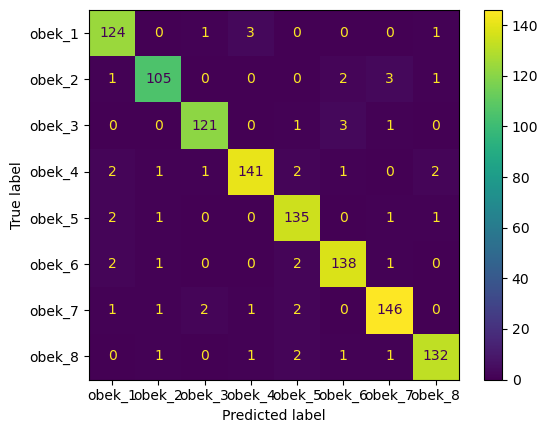

In [66]:
# CatBoostClassifier (CBC)
model_fit_and_predict(CatBoostClassifier(iterations=1000, task_type="GPU", verbose=0), y_label, X_train, y_train, X_valid, y_valid)

**Bölüm Yorumu (Model Seçimi)**

* En fazla doğruluğu yüksek modellerin ExtraTreesClassifier ile RandomForestClassifier olduğu gözlemleniyor.

* Algoritmaların birbirlerine karşı özel bir öbek tahmin etme üstünlüğünü gözlemlenmemiştir.

* Hiperparametre optimizasyonları için yine de ExtraTreesClassifier ve RandomForestClassifier'a ek olarak LGBMClassifier ve CatBoostClassifier da denenecektir.


# Otomatik Hiperparametre Optimizasyonu

In [67]:
params = {
    "n_estimators" : [75, 100, 150, 200, 250, 500, 1000],
    "min_samples_split" : [1, 3, 5, 7, 10, 15, 20]
}

In [68]:
extc_gscv_model = GridSearchCV( 
    ExtraTreesClassifier(),
    params,
    cv = 5,
    n_jobs = -1,
    verbose = 2).fit(X, y)

extc_gscv_model.best_params_

Fitting 5 folds for each of 49 candidates, totalling 245 fits


{'min_samples_split': 3, 'n_estimators': 200}

In [69]:
rf_gscv_model = GridSearchCV( 
    RandomForestClassifier(),
    params,
    cv = 5,
    n_jobs = -1,
    verbose = 2).fit(X, y)

rf_gscv_model.best_params_

Fitting 5 folds for each of 49 candidates, totalling 245 fits


{'min_samples_split': 5, 'n_estimators': 75}

In [70]:
lgbm_params = {
    "boosting_type" : ['gbdt', "rf"],
    "num_leaves" : [27, 30, 31, 32, 33],
    "learning_rate" : [0.04, 0.1, 0.07, 0.09]
}

In [71]:
lgbm_gscv_model = GridSearchCV( 
    LGBMClassifier(),
    lgbm_params,
    cv = 5,
    n_jobs = -1,
    verbose = 0).fit(X, y)

lgbm_gscv_model.best_params_

[LightGBM] [Fatal] Check failed: config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f at /croot/lightgbm_1677766491914/work/compile/src/boosting/rf.hpp, line 35 .

[LightGBM] [Fatal] Check failed: config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f at /croot/lightgbm_1677766491914/work/compile/src/boosting/rf.hpp, line 35 .

[LightGBM] [Fatal] Check failed: config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f at /croot/lightgbm_1677766491914/work/compile/src/boosting/rf.hpp, line 35 .

[LightGBM] [Fatal] Check failed: config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f at /croot/lightgbm_1677766491914/work/compile/src/boosting/rf.hpp, line 35 .

[LightGBM] [Fatal] Check failed: config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f at /croot/lightgbm_1677766491914/work/compile/sr

[LightGBM] [Fatal] Check failed: config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f at /croot/lightgbm_1677766491914/work/compile/src/boosting/rf.hpp, line 35 .

[LightGBM] [Fatal] Check failed: config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f at /croot/lightgbm_1677766491914/work/compile/src/boosting/rf.hpp, line 35 .

[LightGBM] [Fatal] Check failed: config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f at /croot/lightgbm_1677766491914/work/compile/src/boosting/rf.hpp, line 35 .

[LightGBM] [Fatal] Check failed: config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f at /croot/lightgbm_1677766491914/work/compile/src/boosting/rf.hpp, line 35 .

[LightGBM] [Fatal] Check failed: config->bagging_freq > 0 && config->bagging_fraction < 1.0f && config->bagging_fraction > 0.0f at /croot/lightgbm_1677766491914/work/compile/sr

{'boosting_type': 'gbdt', 'learning_rate': 0.07, 'num_leaves': 33}

In [72]:
model_list = [
    
    ExtraTreesClassifier(**extc_gscv_model.best_params_), #0
    
    ExtraTreesClassifier(), #1
    
    RandomForestClassifier(**rf_gscv_model.best_params_), #2
    
    RandomForestClassifier(), #3
    
    LGBMClassifier(**lgbm_gscv_model.best_params_), #4
    
    LGBMClassifier() #5
    
    
]

fast_model_select(model_list, X, y)

Model 0 Accuracy: %95.45787545787546
Model 1 Accuracy: %95.40293040293041
Model 2 Accuracy: %95.47619047619048
Model 3 Accuracy: %95.45787545787546
Model 4 Accuracy: %93.58974358974358
Model 5 Accuracy: %93.003663003663


In [73]:
extc_gscv_model.best_params_ = {'min_samples_split': 3, 'n_estimators': 100}
rf_gscv_model.best_params_ = {'min_samples_split': 3, 'n_estimators': 200}

En yüksek doğruluğa sahip 2 modelimizi seçerek onlarla tahminlerimizi yaptırıyoruz.

In [74]:
model1 = ExtraTreesClassifier().fit(X, y)

In [75]:
model2 = RandomForestClassifier().fit(X, y)

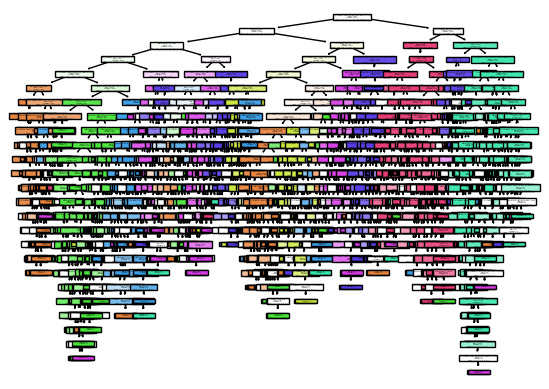

In [76]:
from sklearn import tree
tree.plot_tree(model1.estimators_[0], feature_names=X.columns, filled=True)
plt.show()

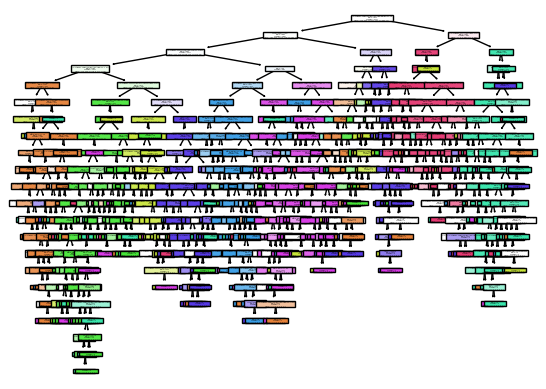

In [77]:
tree.plot_tree(model2.estimators_[0], feature_names=X.columns, filled=True) #, max_depth=5
plt.show()

# Tahmin

Submission verilerimizi de modelimizin eğitildiği veri formatına sokuyoruz.

In [78]:
add_round_feature_df_sub = df_sub.copy()
add_round_feature_df_sub = round_feature(add_round_feature_df_sub)
print(f"df_sub.shape: {df_sub.shape}\nadd_round_feature_df_sub.shape: {add_round_feature_df_sub.shape}")

df_sub.shape: (2340, 13)
add_round_feature_df_sub.shape: (2340, 20)


In [79]:
sub_X = add_round_feature_df_sub.copy()

object_cols, d = calc_object_cols(sub_X, 0)

ordinal_encoder = OrdinalEncoder()
sub_X[object_cols] = ordinal_encoder.fit_transform(sub_X[object_cols])

In [80]:
preds1 = model1.predict(sub_X)
preds1[:20]

array([2, 2, 1, 5, 0, 1, 0, 7, 6, 7, 5, 6, 7, 3, 3, 7, 6, 7, 3, 6])

In [81]:
# labellerimizi buluyoruz.
y_preds_labelled_1 = l_fit.inverse_transform([i for i in preds1])
y_preds_labelled_1

array(['obek_3', 'obek_3', 'obek_2', ..., 'obek_7', 'obek_5', 'obek_6'],
      dtype=object)

In [82]:
preds2 = model2.predict(sub_X)
preds2[:20]

array([2, 2, 1, 5, 0, 1, 0, 7, 6, 7, 5, 6, 7, 3, 3, 7, 6, 7, 3, 6])

In [83]:
# labellerimizi buluyoruz.
y_preds_labelled_2 = l_fit.inverse_transform([i for i in preds2])
y_preds_labelled_2

array(['obek_3', 'obek_3', 'obek_2', ..., 'obek_7', 'obek_5', 'obek_6'],
      dtype=object)

# Submission Dosyalarını Oluşturma

In [84]:
def sub2ready(y_preds_labelled):
    sub = pd.DataFrame(data=y_preds_labelled, columns=["Öbek İsmi"])
    sub = sub.reset_index()
    sub = sub.rename(columns={"index": "id"})
    
    return sub

In [85]:
sub1 = sub2ready(y_preds_labelled_1)
sub2 = sub2ready(y_preds_labelled_2)

In [86]:
sub1.to_csv('sub1.csv', index=False, encoding='utf-8')
sub2.to_csv('sub2.csv', index=False, encoding='utf-8')

# Karşılaştırma

In [87]:
df_different = sub1 != sub2
print(df_different)

         id  Öbek İsmi
0     False      False
1     False      False
2     False      False
3     False      False
4     False      False
...     ...        ...
2335  False      False
2336  False      False
2337  False      False
2338  False      False
2339  False      False

[2340 rows x 2 columns]


In [88]:
row_idx, col_idx = np.where(df_different)

In [89]:
row_idx = np.unique(row_idx)
print(row_idx)

[329 866]


In [90]:
et = time.time()

elapsed_time = et - st
print('Çalışma Zamanı:', elapsed_time, 'saniye')

Çalışma Zamanı: 532.0032932758331 saniye


# Bonus +5 Puan

Birkaç algoritmayla eğitim yaptıktan sonra submission skorlarını ve submission tahmin verilerini karşılaştırdım. Yukarıda görüldüğü üzere 2 algoritmanın farklı sınıflandırdığı 2 tane veri gözüküyor. Algoritmaları çaprazlayarak ve bu verilerin değişkenlerini okuyup genel veri görselleştirmelerime de bakarak bazı öbekleri elle tahmin ettim.